In [ ]:
from google.colab import drive
drive.mount('/gdrive', force_remount=True)

In [ ]:
import os
%cd E:\Summer2021Research\lvl5_sample

E:\Summer2021Research\lvl5_sample


In [ ]:
# install dependencies:
!pip install pyyaml==5.1

In [ ]:
!pip install torch==1.8.0+cu111 torchvision==0.9.0+cu111 torchaudio==0.8.0 -f https://download.pytorch.org/whl/torch_stable.html

In [ ]:
!gcc --version
# opencv is pre-installed on colab

# install detectron2: (Colab has CUDA 10.1 + torch 1.6)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html --user
exit(0)

In [ ]:
# Non-colab installation
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

ERROR: Invalid requirement: "'git+https://github.com/facebookresearch/detectron2.git'"


In [ ]:
from os import listdir
from os.path import isfile, join, isdir
from PIL import Image

def ResizeFolder(path, size):

  directories = [d for d in listdir(path) if isdir(join(path, d))]

  # Recursively run on sub directories 
  for directory in directories:
    ResizeFolder(join(path, directory), size)

  onlyfiles = [f for f in listdir(path) if isfile(join(path, f))]

  for file in onlyfiles:
    img_path = join(path, file)
    with Image.open(img_path) as img:
      img = img.resize(size)
      img.save(img_path)

In [ ]:
# root = 'E:\\Summer2021Research\\Udacity\\export'
# img_size = (640, 480)

# ResizeFolder(root, img_size)

In [5]:
import torch, torchvision
from torchvision import transforms
print(torch.__version__, torchvision.__version__,  torch.cuda.is_available())
assert torch.__version__.startswith("1.8")

# import some common libraries
import numpy as np
from PIL import Image
import os, json, glob, cv2, random, pickle
from pycocotools.coco import COCO

#%cd /gdrive/My Drive/

# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# %cd /gdrive/My Drive/github/Chicken-Behavior-Tracker/Won
# from detectron2_wrapper import register_datasets, evaluate, check_annotations, get_detector

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.modeling import build_model
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.structures import BoxMode
from detectron2.data.datasets import register_coco_instances
# another equivalent way to evaluate the model is to use `trainer.test`

1.8.1+cu111 0.9.1+cu111 True


In [6]:
def coco2detectron(root, annFile, classes):
    """ for each image, you check the number of ground truth and predicted objects from our model, then determine if the prediction finds at least one object of interest
    
    returns: 
        - dataset_dicts
        
    params:
        - root: 
        - annFile: 
        - classes:
    """
    thing_dataset_id_to_contiguous_id={1: 0, 2: 1, 3: 2, 4: 3, 5: 4, 6: 5, 7: 6, 8: 7, 9: 8, 10: 9, 11: 10, 13: 11, 14: 12, 15: 13, 16: 14, 17: 15, 18: 16, 19: 17, 20: 18, 21: 19, 22: 20, 23: 21, 24: 22, 25: 23, 27: 24, 28: 25, 31: 26, 32: 27, 33: 28, 34: 29, 35: 30, 36: 31, 37: 32, 38: 33, 39: 34, 40: 35, 41: 36, 42: 37, 43: 38, 44: 39, 46: 40, 47: 41, 48: 42, 49: 43, 50: 44, 51: 45, 52: 46, 53: 47, 54: 48, 55: 49, 56: 50, 57: 51, 58: 52, 59: 53, 60: 54, 61: 55, 62: 56, 63: 57, 64: 58, 65: 59, 67: 60, 70: 61, 72: 62, 73: 63, 74: 64, 75: 65, 76: 66, 77: 67, 78: 68, 79: 69, 80: 70, 81: 71, 82: 72, 84: 73, 85: 74, 86: 75, 87: 76, 88: 77, 89: 78, 90: 79}
    dataset_dicts = [] # list[dict]

    coco = COCO(annFile) # load entire coco annotation file
    ids = sorted(coco.getImgIds(catIds=coco.getCatIds(catNms=classes))) # get list of image ids
    print("number of images in {} = {}".format(classes, len(ids)))

    for img_id in ids:
        ann_ids = coco.getAnnIds(imgIds=img_id) # load annotation ids related to that image id
        coco_annotation = coco.loadAnns(ann_ids) # load annotation labels in that image id from annotation ids
        path = coco.loadImgs(img_id)[0]['file_name'] # load image annotation related to that image id

        record = {} # dict for single image

        record["file_name"] = os.path.join(root, path) # must be full path to where the image is
        height, width = cv2.imread(record['file_name']).shape[:2]

        record["image_id"] = img_id # must be unique across #s
        record["height"] = height
        record["width"] = width

        objs = [] # list[dict]: for each object in the image

        for i in range(len(coco_annotation)):
            xmin = np.round(coco_annotation[i]['bbox'][0], 2)
            ymin = np.round(coco_annotation[i]['bbox'][1], 2)
            xmax = np.round(xmin + coco_annotation[i]['bbox'][2], 2)
            ymax = np.round(ymin + coco_annotation[i]['bbox'][3], 2)

            obj = {
            "bbox": [xmin, ymin, xmax, ymax],
            "bbox_mode": BoxMode.XYXY_ABS,
            "category_id": thing_dataset_id_to_contiguous_id[coco_annotation[i]['category_id']]            
            }
            objs.append(obj)

        record["annotations"] = objs
        
        dataset_dicts.append(record) # list[dict]

    return dataset_dicts

In [7]:
import matplotlib.pyplot as plt

class SubCocoDetection(torch.utils.data.Dataset):
    """`MS Coco Detection <http://mscoco.org/dataset/#detections-challenge2016>`_ Dataset.

    Args:
    root (string): Root directory where images are downloaded to.
    annFile (string): Path to json annotation file.
    transform (callable, optional): A function/transform that  takes in an PIL image and returns a transformed version. E.g, ``transforms.ToTensor``
    target_transform (callable, optional): A function/transform that takes in the target and transforms it.
    transforms (callable, optional): A function/transform that takes input sample and its target as entry and returns a transformed version.
    """

    def __init__(self, root, annFile, classes, img_resize=None, id_shift=None, transform=None, target_transform=None, transforms=None):
        # super(CocoDetection, self).__init__(root, transforms, transform, target_transform)
        self.root = root
        self.coco = COCO(annFile) # load entire coco annotation file
        self.transforms = transforms
        print("INIT CLASSES: ", classes)
        self.ids = sorted(self.coco.getImgIds(catIds=self.coco.getCatIds(catNms=classes))) # get list of image ids (indices?) 
        print("LENGTH: ", len(self.ids))
        self.img_resize = img_resize
        self.id_shift = id_shift
        print("number of images in {} = {}".format(classes, len(self.ids)))

    def __getitem__(self, index):
        """
        Args:
            index (int): index

        Returns:
            img, target (tuple): target is the object returned by ``coco.loadAnns``.
        """

        thing_dataset_id_to_contiguous_id = self.id_shift if self.id_shift is not None else {1: 0, 2: 1, 3: 2, 4: 3, 5: 4, 6: 5, 7: 6, 8: 7, 9: 8, 10: 9, 11: 10, 13: 11, 14: 12, 15: 13, 16: 14, 17: 15, 18: 16, 19: 17, 20: 18, 21: 19, 22: 20, 23: 21, 24: 22, 25: 23, 27: 24, 28: 25, 31: 26, 32: 27, 33: 28, 34: 29, 35: 30, 36: 31, 37: 32, 38: 33, 39: 34, 40: 35, 41: 36, 42: 37, 43: 38, 44: 39, 46: 40, 47: 41, 48: 42, 49: 43, 50: 44, 51: 45, 52: 46, 53: 47, 54: 48, 55: 49, 56: 50, 57: 51, 58: 52, 59: 53, 60: 54, 61: 55, 62: 56, 63: 57, 64: 58, 65: 59, 67: 60, 70: 61, 72: 62, 73: 63, 74: 64, 75: 65, 76: 66, 77: 67, 78: 68, 79: 69, 80: 70, 81: 71, 82: 72, 84: 73, 85: 74, 86: 75, 87: 76, 88: 77, 89: 78, 90: 79}
        coco = self.coco
        img_id = self.ids[index] # get one image id according to the index
        ann_ids = coco.getAnnIds(imgIds=img_id) # load annotation ids related to that image id

        coco_annotation = coco.loadAnns(ann_ids) # load annotation labels in that image id from annotation ids
      
        coco_img = coco.loadImgs(img_id)[0]
        height = coco_img['height']
        width = coco_img['width']

        path = coco_img['file_name'] # load image annotation related to that image id
        img = Image.open(os.path.join(self.root, path)).convert('RGB') # open the PIL image
        # number of objects in the image
        num_objs = len(coco_annotation)

        # Bounding boxes for objects
        # In coco format, bbox = [xmin, ymin, width, height]
        # In pytorch, the input should be [xmin, ymin, xmax, ymax]
        boxes = []
        labels = []

        for i in range(num_objs):
            xmin = coco_annotation[i]['bbox'][0]
            ymin = coco_annotation[i]['bbox'][1]
            xmax = xmin + coco_annotation[i]['bbox'][2]
            ymax = ymin + coco_annotation[i]['bbox'][3]

            if self.img_resize is not None:
              x_resize = self.img_resize[0] / width
              y_resize = self.img_resize[1] / height
              xmin *= x_resize
              xmax *= x_resize
              ymin *= y_resize
              ymax *= y_resize

              img = img.resize(self.img_resize)

            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(thing_dataset_id_to_contiguous_id[coco_annotation[i]['category_id']])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        img_id = torch.tensor([img_id])    
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        # Annotation is in dictionary format
        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = img_id
        target["iscrowd"] = iscrowd

        # preprocess image if wanted
        if self.transforms is not None:
            print('transforms not none')
            img = self.transforms(img)

        return img, target

    def show_item(self, index):
        """
        Args:
            index (int): index

        Returns:
            img, target (tuple): target is the object returned by ``coco.loadAnns``.
        """

        thing_dataset_id_to_contiguous_id={1: 0, 2: 1, 3: 2, 4: 3, 5: 4, 6: 5, 7: 6, 8: 7, 9: 8, 10: 9, 11: 10, 13: 11, 14: 12, 15: 13, 16: 14, 17: 15, 18: 16, 19: 17, 20: 18, 21: 19, 22: 20, 23: 21, 24: 22, 25: 23, 27: 24, 28: 25, 31: 26, 32: 27, 33: 28, 34: 29, 35: 30, 36: 31, 37: 32, 38: 33, 39: 34, 40: 35, 41: 36, 42: 37, 43: 38, 44: 39, 46: 40, 47: 41, 48: 42, 49: 43, 50: 44, 51: 45, 52: 46, 53: 47, 54: 48, 55: 49, 56: 50, 57: 51, 58: 52, 59: 53, 60: 54, 61: 55, 62: 56, 63: 57, 64: 58, 65: 59, 67: 60, 70: 61, 72: 62, 73: 63, 74: 64, 75: 65, 76: 66, 77: 67, 78: 68, 79: 69, 80: 70, 81: 71, 82: 72, 84: 73, 85: 74, 86: 75, 87: 76, 88: 77, 89: 78, 90: 79}
        coco = self.coco
        img_id = self.ids[index] # get one image id according to the index
        ann_ids = coco.getAnnIds(imgIds=img_id) # load annotation ids related to that image id

        coco_annotation = coco.loadAnns(ann_ids) # load annotation labels in that image id from annotation ids
      
        coco_img = coco.loadImgs(img_id)[0]
        height = coco_img['height']
        width = coco_img['width']

        path = coco_img['file_name'] # load image annotation related to that image id
        img = Image.open(os.path.join(self.root, path)).convert('RGB') # open the PIL image
        
        # number of objects in the image
        num_objs = len(coco_annotation)

        # Bounding boxes for objects
        # In coco format, bbox = [xmin, ymin, width, height]
        # In pytorch, the input should be [xmin, ymin, xmax, ymax]
        boxes = []
        labels = []

        for i in range(num_objs):
            xmin = coco_annotation[i]['bbox'][0]
            ymin = coco_annotation[i]['bbox'][1]
            xmax = xmin + coco_annotation[i]['bbox'][2]
            ymax = ymin + coco_annotation[i]['bbox'][3]

            if self.img_resize is not None:
       
              x_resize = self.img_resize[0] / width
              y_resize = self.img_resize[1] / height
              xmin *= x_resize
              xmax *= x_resize
              ymin *= y_resize
              ymax *= y_resize  
              print('resizes: ', x_resize, y_resize)

            else:
              print('resize none')

            print('category: ', coco.cats[coco_annotation[i]['category_id']])
            plt.imshow(img)
            plt.scatter([xmin, xmin, xmax, xmax], [ymin, ymax, ymin, ymax], c='pink')
            plt.show()

            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(thing_dataset_id_to_contiguous_id[coco_annotation[i]['category_id']])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        img_id = torch.tensor([img_id])    
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        # Annotation is in dictionary format
        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = img_id
        target["iscrowd"] = iscrowd

        # preprocess image if wanted
        if self.transforms is not None:
            img = self.transforms(img)

    def __len__(self):
        return len(self.ids)


def get_transform():
    custom_transforms = []
    custom_transforms.append(transforms.Resize((640, 480)))
    return transforms.Compose(custom_transforms)


def filter_pos_pred(dataset, model, cls, cfg, max_img):
    """ to completely isolate the effect of the perturbation, we have to only use the images that the detector results in correct prediction
    
    returns: 
        - train_data: list[tuple], images that have at least one correct prediction of our target class

    params:
        - dataset: the dataset that we want to filter out
        - model: the object detector we want to test on
        - cls: the target class that we are interested in
        - cfg: config file that contains class category strings for COCO2017 train
        - max_img: max number of images that we want to keep as training data
    """

    # split into train and val data
    train_data = []
    gt_total_count = 0
    pred_total_count = 0
    img_num = 0

    print("filter_pos_pred len dataset: ", len(dataset))

    for i in range(len(dataset)):
        is_correct, gt_count, pred_count = is_pos_pred(dataset[i], model, cls, cfg) # dataset[i]=Pil Object
        if is_correct is True:
            train_data.append(dataset[i])
            img_num += 1
            gt_total_count += gt_count
            pred_total_count += pred_count

            # finish if collected images exceed the desired number of training examples
            if img_num >= max_img:
                break
            
    print('ground truth # of classes for filtered images: {}, predicted # of classes for filtered images: {}'.format(gt_total_count, pred_total_count))
    print('number of filtered images: {}'.format(len(train_data)))
    return train_data


def is_pos_pred(data, model, cls, cfg):
    """ for each image, you check the number of ground truth and predicted objects from our model, then determine if the prediction finds at least one object of interest
    
    returns: 
        - is_pos_pred: boolean, the prediction finds at least one correct object detection of interest
        - gt_count: int, the number of ground truth objects of our interest in the image
        - pred_count: int, the number of predicted objects of our interest in the image

    params:
        - data:
        - model: the object detector we want to test on
        - cls: the target class that we are interested in
        - cfg: config file that contains class category strings for COCO2017 train
    """
       
    # convert image PIL to torch tensor 
    img, target = data

    pred_count = 0
    gt_count = np.sum((target["labels"].numpy() == cls)) # How many of the objects in the image are of the specified class

    is_pos_pred = False
    
    img = np.array(img) # convert image PIL to numpy
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    #cv2_imshow(img)
    img_t = torch.from_numpy(img).float() # convert numpy to torch tensor
    img_t = img_t.permute(2, 0, 1) # (H, W, C) to (C, H, W)
    
    # add universal adversarial perturbation to clean image
    img_dict = [dict(image=img_t)] # for detectron2 format

    # run detection on the model and get the confidence scores of the detections
    outputs = model(img_dict)[0]
    outputs = outputs['instances']

    outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)

    # for each instance prediction, 
    for idx, pred_cls in enumerate(outputs.pred_classes):
      # check that predicted class is the target class 
      if pred_cls.item() == cls:
          max = 0
          max_i = 0

          # compare it with all ground truth boxes of the target class
          for i, gt_labels in enumerate(target["labels"]):

              # if the gt box is the target class, compute their iou to see if it's true positive
              if gt_labels.item() == pred_cls:
                  gt_box = target['boxes'][i]
                  pred_bbox = outputs.pred_boxes.tensor[idx].cpu().numpy()

                  # (For Cyclist Category) Doubling size to account for annotation including riders of bicyles
                  pred_bbox[1] -= pred_bbox[3] - pred_bbox[1] 

                  overlap = bb_intersection_over_union(pred_bbox, gt_box.numpy())

                  if overlap > 0.5:
                      is_pos_pred = True
                      pred_count += 1
                      break
                  elif overlap > max:
                    max = overlap
                    max_i = i

          #Displays the predicted and closest actual bounding box

          pred_bbox = outputs.pred_boxes.tensor[idx].cpu().numpy()
          # pred_bbox[1] -= pred_bbox[3] - pred_bbox[1] 
          b1 = pred_bbox
          b2 = target['boxes'][max_i].numpy()
          print(b2)
          pred_x = [b1[0], b1[0], b1[2], b1[2]]
          act_x = [b2[0], b2[0], b2[2], b2[2]]
          pred_y = [b1[1], b1[3], b1[1], b1[3]]
          act_y = [b2[1], b2[3], b2[1], b2[3]]
          plt.imshow(img)
          print(img.shape)
          plt.scatter(pred_x, pred_y, c='red')
          plt.scatter(act_x, act_y, c='green')
          plt.show()
          print(is_pos_pred)
      else:
        print(pred_cls.item(), ' vs ', cls)
                        
    return is_pos_pred, gt_count, pred_count


def bb_intersection_over_union(boxA, boxB):
    """ for each image you make an prediction and find the indexes of correctly classified rois
    
    returns: 
        - iou: float, intersection over union between two bounding boxes

    params:
        - boxA: 
        - boxB:
    """

    # determine the (x, y)-coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    # compute the area of intersection rectangle
    interArea = abs(max((xB - xA, 0)) * max((yB - yA), 0))
    if interArea == 0:
        return 0

    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = abs((boxA[2] - boxA[0]) * (boxA[3] - boxA[1]))
    boxBArea = abs((boxB[2] - boxB[0]) * (boxB[3] - boxB[1]))

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / float(boxAArea + boxBArea - interArea)

    # return the intersection over union value
    return iou

In [8]:
def loss_fn(outputs, uap, cls, p=np.inf):
    """ the objective function aims to lower the confidence scores of the objects of target class in the detection results
    while keep the perturbatio norm as small as possible
    
    returns: 
        - loss: loss value for the prediction of the image

    params:
        - outputs:
        - uap:
        - cls:
    """
    
    scores = outputs['instances'].scores
   
    # when the target is the entire set of classes
    if cls == -1:
        loss = scores.sum()
        if p == np.inf:
            loss += torch.max(torch.abs(uap))
        elif p == 1:
            loss += torch.mean(torch.abs(uap))

        return loss
        
    # when the target is a specific class
    else:
        pred_classes = outputs['instances'].pred_classes
        loss = scores[pred_classes == cls].sum()
        if p == np.inf:
            loss += torch.max(torch.abs(uap))
        elif p == 1:
            loss += torch.mean(torch.abs(uap))

        return loss


def udos(cfg, model, dataset, n_epochs, Xi, epsilon, size, cls=-1):
    """create a universal perturbation that attacks a set of images at once

    returns: 
        - uap: loss value for the prediction of the image
        - metric_ls: 

    params:
        - cfg:
        - model:
        - datsets:
        - n_epochs:
        - Xi:
        - epsilon:
        - cls:
    """

    # initialize variables
    metric_ls = [] # list of lists storing metrics for each epoch
    n = len(dataset) # of images in the attack set I
    uap = torch.zeros(1) # universal perturbation that we want to compute from the attack set I
    width, height = size # of images
    v = torch.zeros(len(dataset), 3, height, width, dtype=torch.float) # gradient computed from each image to update universal perturbation, width x height was originally 640x480

    
    # for each epoch
    for epoch in range(n_epochs):
        print("epoch {}".format(epoch+1))

        # (re)initialize metrics: loss, instance-level blind degree, image-level blind degree
        inst_blind_deg = 0
        img_blind_deg = 0
        total_loss = 0

        uap_norm = -1
        
        # for each image
        for i, data in enumerate(dataset):

            # convert image to the format list[dict] that model accepts as input
            img, _ = data
            img = np.array(img) # convert it to numpy
            img_t = torch.from_numpy(img).float() # convert numpy to torch tensor
            img_t = img_t.permute(2, 0, 1) # (H, W, C) to (C, H, W)
            img_t.requires_grad = True # set True to calculate gradient for this tensor

            img_dict = [dict(image=img_t + uap)] # add perturbation to clean image

            outputs = model(img_dict)[0] # run detection on the model

            # get confidence scores and class predictions on all the detection instances
            scores = outputs['instances'].scores
            pred_classes = outputs['instances'].pred_classes
            
            # given that current perturbation haven't failed the detector to detect no objects in this image, we keep optimizing the perturbation for this image
            if len(scores[pred_classes == cls]) != 0:
                train_loss = loss_fn(outputs, uap, cls, 1)
                
                model.zero_grad() # zero all existing gradients
                img_dict[0]['image'].retain_grad() # this is needed as the image is not in the leaf-node

                # Calculate gradients of model through backward pass
                train_loss.backward()

                # update v_i by step size multipled by the gradient of loss w.r.t to perturbed_image
                v[i] -= epsilon * img_dict[0]['image'].grad.data # gradient that blinds the image
                            
                # project the updated universal perturbation to the nearest point that satisfies the constraint Xi
                uap = torch.clamp(uap + v[i], min=-Xi, max=Xi)
                uap_norm = torch.mean(torch.abs(uap)) # minimize, make perturbation imperceptible to humans

                # calculate metrics
                inst_blind_deg = inst_blind_deg + (float(train_loss) - uap_norm)
                img_blind_deg = img_blind_deg + 1 # add image-level if the detector finds at least one object beyond score threhold
                total_loss = total_loss + float(train_loss)
                
        # calculate average metrics for this epoch

        if n != 0:
          inst_blind_deg = inst_blind_deg / n
          img_blind_deg = img_blind_deg / n
          total_loss = total_loss / n
        else:
          print('data set size 0')
        print("loss: {}, perturbation l1-norm: {}, instance_level_blind_deg: {}, img_level_blind_deg: {}".format(total_loss, uap_norm, inst_blind_deg, img_blind_deg))
        metric_ls.append((total_loss, uap_norm, inst_blind_deg, img_blind_deg)) # append metric for this epoch to this list for later visualization


    return uap, metric_ls

In [9]:
def get_detector(config_file, nms_thresh, data_type, weight_dir=None, dataset_name=None):
  """ for each image you make an prediction and find the indexes of correctly classified rois
  
  returns: 
      - model: object detector(nn.module)
      - cfg: config file for the module
  params:
      - config_file: filename
      - nms_thresh: it determins the minimum confidence threshold for rois to survive for non-max suppression
      - data_type: e.g. 'model'
      - weight_file: 
  """
  cfg = get_cfg() # from detectron2.config.get_cfg()

  # add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
  cfg.merge_from_file(model_zoo.get_config_file(config_file))

  # set threshold for this model
  cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = nms_thresh  

  # Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
  if weight_dir is None:
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(config_file) # use the pretrained weights

  else:
    cfg.MODEL.WEIGHTS = os.path.join(weight_dir, 'model_final.pth') # use the custom trained weights
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(MetadataCatalog.get(dataset_name).thing_classes)  # number of classes 

  if data_type == 'model':
    model = build_model(cfg)  # returns a torch.nn.Module
    DetectionCheckpointer(model).load(cfg.MODEL.WEIGHTS)
    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
    model = model.to(device)
    model.eval()

  if data_type == 'predictor':
    model = DefaultPredictor(cfg)

  return model, cfg

# Carefully selecting the dataset by filtering only the correct predictions

In [ ]:
# COCO2017 Main

faster_rcnn = "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"
mask_rcnn =  "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
config_file = mask_rcnn

%cd 'E:\Summer2021Research\Temp'

root = 'E:\Summer2021Research\COCO2017\val2017'
annFile = '/gdrive/My Drive/Summer2021Research/datasets/coco/annotations/instances_val2017.json'
n_epochs = 1
Xi = 10 # [10, 15, 20]
eps = 20 # [1, 5, 10, 20, 30] 
n_imgs = 50
score_thresh = 0.7
iou_thresh = 0.5

model, cfg = get_detector(config_file, score_thresh, data_type='model')

# person=0, bicycle=1, car=2, motorcycle=3, bus=5, truck=7, traffic light=9, stop sign=11
cls_strs = [['person'], ['car'], ['truck'], ['traffic light'], ['stop sign']]
cls_idxs = [0, 2, 7, 9, 11]

for cls_str, cls_idx in zip(cls_strs, cls_idxs):
    print(annFile)

    coco = SubCocoDetection(root=root, annFile=annFile, classes=cls_str, transforms=get_transform()) # Object Instance
    # dataset_dict = coco2detectron(root, annFile, cls_str) # Takes 6+ minutes to run, prints the same thing as SubCocoDetection
    dataset_name = "coco_{}".format(cls_str)

    # evaluate the mAP of the clean image set 
    # register_datasets(dataset_name, cfg, root, annFile, cls_str)
    # evaluate(dataset_name, cfg, model)

    train_data = filter_pos_pred(coco, model, cls_idx, cfg, n_imgs) # outputs a bunch of images, based on coco api
    
    print("class: {}, n_epochs: {}, Xi: {}, epsilon: {}, number of imgs: {}".format(cls_str, n_epochs, Xi, eps, len(train_data)))

    uap, metric_ls = udos(cfg=cfg, model=model, dataset=train_data, n_epochs=n_epochs, Xi=Xi, epsilon=eps, size=img_size, cls=cls_idx)
    metrics = np.array(metric_ls)

    # save list to pickle file
    file_name = 'cls{}_epochs{}_xi{}_eps{}_imgs{}.pkl'.format(cls_str, n_epochs, Xi, eps, len(train_data))
    open_file = open(file_name, "wb")
    pickle.dump(metrics, open_file)
    open_file.close()

In [ ]:
from detectron2.data import MetadataCatalog
print(MetadataCatalog.get("coco_2017_val").thing_classes)

['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']


In [ ]:
cls_str = cls_strs[0]
cls_idx = cls_idxs[0]

coco = SubCocoDetection(root=root, annFile=annFile, classes=cls_str, transforms=get_transform()) # Object Instance
# dataset_dict = coco2detectron(root, annFile, cls_str) # Takes 6+ minutes to run, prints the same thing as SubCocoDetection
dataset_name = "coco_{}".format(cls_str)

# evaluate the mAP of the clean image set 
# register_datasets(dataset_name, cfg, root, annFile, cls_str)
# evaluate(dataset_name, cfg, model)

train_data = filter_pos_pred(coco, model, cls_idx, cfg, n_imgs) # outputs a bunch of images
train_images = [img for (img, ann) in train_data]

print("class: {}, n_epochs: {}, Xi: {}, epsilon: {}, number of imgs: {}".format(cls_str, n_epochs, Xi, eps, len(train_data)))

uap, metric_ls = udos(cfg=cfg, model=model, dataset=train_images, n_epochs=n_epochs, Xi=Xi, epsilon=eps, img_size, cls=cls_idx)
metrics = np.array(metric_ls)


loading annotations into memory...
Done (t=3.60s)
creating index...
index created!
number of images in ['person'] = 2693


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:158: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


ground truth # of classes for filtered images: 165, predicted # of classes for filtered images: 74
number of filtered images: 50
class: ['person'], n_epochs: 2, Xi: 10, epsilon: 20, number of imgs: 50
epoch 1
loss: 1.8001562941074372, perturbation l1-norm: 0.0007377862348221242, instance_level_blind_deg: 1.7996505498886108, img_level_blind_deg: 0.98
epoch 2
loss: 1.800670017004013, perturbation l1-norm: 0.002232982311397791, instance_level_blind_deg: 1.7989916801452637, img_level_blind_deg: 0.98


In [ ]:
from detectron2.data import MetadataCatalog
level5data.list_categories()

Category stats
bus                         n=  126, width= 2.65±0.00, len=18.95±0.00, height= 3.51±0.00, lw_aspect= 7.16±0.00
car                         n= 6062, width= 1.94±0.16, len= 4.72±0.42, height= 1.70±0.20, lw_aspect= 2.44±0.18
other_vehicle               n=   41, width= 2.10±0.00, len= 5.26±0.00, height= 2.55±0.00, lw_aspect= 2.51±0.00
pedestrian                  n=  426, width= 0.69±0.13, len= 0.75±0.15, height= 1.78±0.15, lw_aspect= 1.10±0.21
truck                       n=  407, width= 2.86±0.38, len=10.11±2.77, height= 3.61±0.48, lw_aspect= 3.51±0.72


**Nuimages Main**

In [ ]:
!mkdir -p /data/sets/nuimages  # Make the directory to store the nuImages dataset in.

!wget https://www.nuscenes.org/data/nuimages-v1.0-mini.tgz  # Download the nuImages mini split.

!tar -xf nuimages-v1.0-mini.tgz -C /data/sets/nuimages  # Uncompress the nuImages mini split.

!pip install nuscenes-devkit &> /dev/null  # Install nuImages.

In [ ]:
from nuimages import NuImages

class SubNuimDetection(torch.utils.data.Dataset):
    """

    Args:
    root (string): Root directory where images are downloaded to.
    classes (string array): Names of categories we want in NuImages format
    img_resize (int 2-tuple): image's current resized size

    transform (callable, optional): A function/transform that  takes in an PIL image and returns a transformed version. E.g, ``transforms.ToTensor``
    target_transform (callable, optional): A function/transform that takes in the target and transforms it.
    transforms (callable, optional): A function/transform that takes input sample and its target as entry and returns a transformed version.
    """

    def __init__(self, root, classes, model, coco_cls, cfg, max_img, img_resize=None, transform=None, target_transform=None, transforms=None):
        self.root = root
        self.transforms = transforms
        self.classes = classes

        # NuImage tokens attached to the index of their corresponding Coco class indexes
        nuim_samp_cats_to_coco_ids = {'fc95c87b806f48f8a1faea2dcc2222a4':1, '1fa93b757fc74fb197cdd60001ad8abf' : 0, 'b1c6de4c57f14a5383d9f963fbdcb5cb' : 0, '909f1237d34a49d6bdd27c2fe4581d79' : 0, '403fede16c88426885dd73366f16c34a' : 0, 'e3c7da112cd9475a9a10d45015424815' : 0, '6a5888777ca14867a8aee3fe539b56c4' : 0, 'b2d7c6c701254928a9e4d6aac9446d79' : 0, 'fd69059b62a3469fbaef25340c0eab7f' : 2, '6021b5187b924d64be64a702e5570edf' : 7}
        
        nuim = NuImages(dataroot=root, version='v1.0-train', verbose=False, lazy=True)

        # Array of arrays of bounding boxes (4 int arrays)
        boxes = []
        # Array of arrays of coco id labels of imgs
        labels = []

        imgs = []

        # For every annotation of the current category, append token, bbox, etc.
        for fields in nuim.object_ann:

          token = fields['sample_data_token']
          samp_data = nuim.get('sample_data', token)
          category = nuim.get('category', fields['category_token'])

          if category['name'] in classes:

            # resizing bounding boxes
            img_w = samp_data['width']
            img_h = samp_data['height']
            x_resize = img_resize[0] / img_w
            y_resize = img_resize[1] / img_h
            box = fields['bbox']
            box = [box[0] * x_resize, box[1] * y_resize, box[2] * x_resize, box[3] * y_resize]
            
            if token not in imgs:
              imgs.append(token) # Sample data token for every image with an annotation of a category in cat_arr
              boxes.append([box])
              labels.append([nuim_samp_cats_to_coco_ids[category['token']]])

            else:
              index = imgs.index(token)
              boxes[index].append(box)
              labels[index].append(nuim_samp_cats_to_coco_ids[category['token']])

        imgs = [nuim.get('sample_data', token)['filename'] for token in imgs]
        boxes = [torch.as_tensor(box, dtype=torch.float32) for box in boxes]
        labels = [torch.as_tensor(label, dtype=torch.int64) for label in labels]

        # Annotation is in dictionary format
        target = [{'boxes' : curr_boxes, 'labels' : curr_labels} for curr_boxes, curr_labels in zip(boxes, labels)]

        self.dataset = list(zip(imgs, target))
        print('filter')
        self.filter_pos(model, coco_cls, cfg, max_img)

    def __getitem__(self, index):
        """
        Args:
            index (int): index

        Returns:
            img, target (tuple): target is the object returned by ``coco.loadAnns``.
        """

        img, target = self.dataset[index]
        img = Image.open(os.path.join(self.root, img)).convert('RGB') # open the PIL image

        # preprocess image if wanted
        if self.transforms is not None:
            img = self.transforms(img)
            
        return img, target

    def __len__(self):
        return len(self.dataset)

    def filter_pos(self, model, cls, cfg, max_img):
      """ to completely isolate the effect of the perturbation, we have to only use the images that the detector results in correct prediction
      
      returns: 
          - train_data: list[tuple], images that have at least one correct prediction of our target class

      params:
          - dataset: the dataset that we want to filter out
          - model: the object detector we want to test on
          - cls: the target class that we are interested in
          - cfg: config file that contains class category strings for COCO2017 train
          - max_img: max number of images that we want to keep as training data
      """

      # split into train and val data
      train_data = []
      gt_total_count = 0
      pred_total_count = 0
      img_num = 0

      for i in range(len(self.dataset)):
          is_correct, gt_count, pred_count = is_pos_pred(self[i], model, cls, cfg) # dataset[i]=Pil Object
          
          if is_correct is True:
            train_data.append(self.dataset[i])
            img_num += 1
            gt_total_count += gt_count
            pred_total_count += pred_count

            # finish if collected images exceed the desired number of training examples
            if img_num >= max_img:
                break
            
      print('ground truth # of classes for filtered images: {}, predicted # of classes for filtered images: {}'.format(gt_total_count, pred_total_count))
      print('number of filtered images: {}'.format(len(train_data)))
      self.dataset = train_data


In [ ]:
# nuim = NuImages(dataroot='E:/Summer2021Research/NuImages/data/sets/nuimages', version='v1.0-train', verbose=False, lazy=True)

# nuim.category

In [ ]:
from nuimages import NuImages

root = 'E:/Summer2021Research/NuImages/data/sets/nuimages'

faster_rcnn = "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"
mask_rcnn =  "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
config_file = mask_rcnn

# includes animals instead of by species and adult/child instead of pedestrian
cats = ['pedestrian', 'car', 'truck', 'cyclist']
nuim_samp_cats = [['human.pedestrian.adult', 'human.pedestrian.child', 'human.pedestrian.construction_worker', 'human.pedestrian.personal_mobility', 'human.pedestrian.police_officer', 'human.pedestrian.stroller', 'human.pedestrian.wheelchair'], ['vehicle.car'], ['vehicle.truck'], ['vehicle.bicycle']]
nuim_samp_coco_idxs = [0, 2, 7, 1]
# nuim_samp_cat_tokens = ['1fa93b757fc74fb197cdd60001ad8abf', 'b1c6de4c57f14a5383d9f963fbdcb5cb', '909f1237d34a49d6bdd27c2fe4581d79', '403fede16c88426885dd73366f16c34a', 'e3c7da112cd9475a9a10d45015424815', '6a5888777ca14867a8aee3fe539b56c4', 'b2d7c6c701254928a9e4d6aac9446d79', 'fd69059b62a3469fbaef25340c0eab7f', '6021b5187b924d64be64a702e5570edf']
# nuim_samp_cats_to_coco_ids = {'1fa93b757fc74fb197cdd60001ad8abf' : 0, 'b1c6de4c57f14a5383d9f963fbdcb5cb' : 0, '909f1237d34a49d6bdd27c2fe4581d79' : 0, '403fede16c88426885dd73366f16c34a' : 0, 'e3c7da112cd9475a9a10d45015424815' : 0, '6a5888777ca14867a8aee3fe539b56c4' : 0, 'b2d7c6c701254928a9e4d6aac9446d79' : 0, 'fd69059b62a3469fbaef25340c0eab7f' : 2, '6021b5187b924d64be64a702e5570edf' : 7}

%cd E:\Summer2021Research\mask_rcnn\nuimages
# %cd E:\Summer2021Research\NuImages\data\sets\nuimages

n_epochs = 250
Xi = 10 # [10, 15, 20]
eps = 20 # [1, 5, 10, 20, 30] 
n_imgs = 500
score_thresh = 0.7
iou_thresh = 0.5

img_size = (640, 480)


model, cfg = get_detector(config_file, score_thresh, data_type='model')

for cat, cat_arr, cls_idx in zip(cats, nuim_samp_cats, nuim_samp_coco_idxs):

  print(cat)
  dataset = SubNuimDetection(root, cat_arr, model, cls_idx, config_file, n_imgs, img_resize=img_size)
  
  # accepts array of (img matrix, dictionary data with 'box' as [xmin, ymin, xmax, ymax])
  uap, metric_ls = udos(cfg=cfg, model=model, dataset=dataset, n_epochs=n_epochs, Xi=Xi, epsilon=eps, size=img_size, cls=cls_idx)
  metrics = np.array(metric_ls)

  # save list to pickle file
  file_name = 'cls{}_epochs{}_xi{}_eps{}_imgs{}.pkl'.format(cat, n_epochs, Xi, eps, len(dataset))
  open_file = open(file_name, "wb")
  pickle.dump(metrics, open_file)
  open_file.close()


E:\Summer2021Research\mask_rcnn\nuimages


The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


pedestrian
filter


<ipython-input-3-3d6a597a5ce8>:255: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)


ground truth # of classes for filtered images: 4453, predicted # of classes for filtered images: 1308
number of filtered images: 500
epoch 1
loss: 2.344253278017044, perturbation l1-norm: 0.0033851093612611294, instance_level_blind_deg: 2.342231035232544, img_level_blind_deg: 0.936
epoch 2
loss: 2.32141879761219, perturbation l1-norm: 0.010023081675171852, instance_level_blind_deg: 2.3147566318511963, img_level_blind_deg: 0.932
epoch 3
loss: 2.277657868146896, perturbation l1-norm: 0.019500574097037315, instance_level_blind_deg: 2.2636053562164307, img_level_blind_deg: 0.924
epoch 4
loss: 2.2284812791347504, perturbation l1-norm: 0.03155699372291565, instance_level_blind_deg: 2.2046282291412354, img_level_blind_deg: 0.916
epoch 5
loss: 2.160764211654663, perturbation l1-norm: 0.04501264542341232, instance_level_blind_deg: 2.126075267791748, img_level_blind_deg: 0.894
epoch 6
loss: 2.0923604519367216, perturbation l1-norm: 0.060368917882442474, instance_level_blind_deg: 2.04525661468505

**Berkeley Deep Drive 100k**

In [ ]:
coco = COCO(annFile)
print(coco.cats)

test = bdd_cls_idxs + [5, 7, 10]
print(test)
for bdd_cat_id in test:

  print(coco.loadCats(ids=[bdd_cat_id]))
  print(len(coco.getAnnIds(catIds=[bdd_cat_id])))

loading annotations into memory...
Done (t=1.20s)
creating index...
index created!
{1: {'id': 1, 'name': 'pedestrian'}, 2: {'id': 2, 'name': 'rider'}, 3: {'id': 3, 'name': 'car'}, 4: {'id': 4, 'name': 'truck'}, 5: {'id': 5, 'name': 'bus'}, 6: {'id': 6, 'name': 'train'}, 7: {'id': 7, 'name': 'motorcycle'}, 8: {'id': 8, 'name': 'bicycle'}, 9: {'id': 9, 'name': 'traffic light'}, 10: {'id': 10, 'name': 'traffic sign'}}
[1, 3, 4, 9, 2, 5, 7, 10]
[{'id': 1, 'name': 'pedestrian'}]
13426
[{'id': 3, 'name': 'car'}]
102922
[{'id': 4, 'name': 'truck'}]
4245
[{'id': 9, 'name': 'traffic light'}]
26884
[{'id': 2, 'name': 'rider'}]
658
[{'id': 5, 'name': 'bus'}]
1660
[{'id': 7, 'name': 'motorcycle'}]
460
[{'id': 10, 'name': 'traffic sign'}]
34724


In [11]:
# BDD100k Main

%cd E:/Summer2021Research/bdd100k/100k

config_file = "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"
mask_rcnn =  "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
config_file = mask_rcnn

root = 'E:/Summer2021Research/bdd100k/100k/val'
annFile = 'E:/Summer2021Research/bdd100k/bdd100k/labels/det_20/det_val_coco.json'
n_epochs = 250
Xi = 10 # [10, 15, 20]
eps = 20 # [1, 5, 10, 20, 30] 
n_imgs = 500
score_thresh = 0.7
iou_thresh = 0.5

img_size = (640, 480)
id_shift = {2:1, 1:0, 3:2, 4:7, 9:9, 5:-1, 6:-1, 7:-1, 8:-1, 10:-1}
model, cfg = get_detector(config_file, score_thresh, data_type='model')

# person=0, bicycle=1, car=2, motorcycle=3, bus=5, truck=7, traffic light=9, stop sign=11
cls_strs = [['pedestrian'], ['car'], ['truck'], ['traffic light'], ['rider']]
cls_idxs = [0, 2, 7, 9, 1]
bdd_cls_idxs = [1, 3, 4, 9, 2]  

E:\Summer2021Research\bdd100k\100k


The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


['rider']
2
loading annotations into memory...
Done (t=2.14s)
creating index...
index created!
INIT CLASSES:  ['rider']
LENGTH:  527
number of images in ['rider'] = 527
filter_pos_pred len dataset:  527


<ipython-input-7-1ad0961237bb>:255: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)


2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
0  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
3  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
7  vs  1
9  vs  1
0  vs  1
0  vs  1
9  vs  1
7

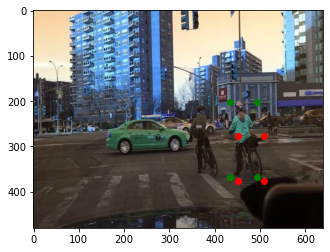

False
2  vs  1
9  vs  1
0  vs  1
[343.19406 211.4493  405.75525 361.29593]
(480, 640, 3)


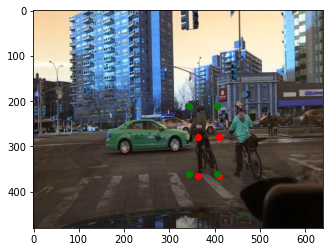

False
2  vs  1
9  vs  1
9  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
9  vs  1
7  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[350.51773 203.65707 413.1177  332.1237 ]
(480, 640, 3)


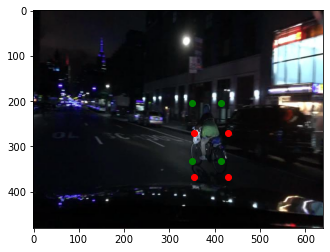

False
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
3  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[412.38272 211.28635 443.4527  310.10968]
(480, 640, 3)


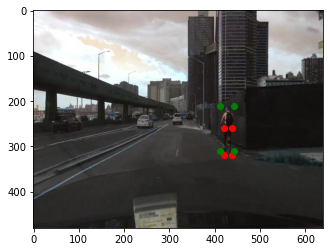

False
2  vs  1
2  vs  1
[533.22955 261.67975 555.94684 322.39542]
(480, 640, 3)


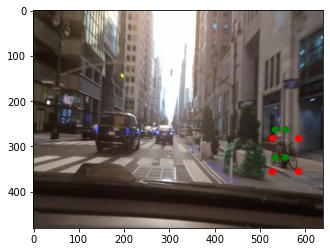

False
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
9  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
[351.95953 155.47488 360.05325 175.26654]
(480, 640, 3)


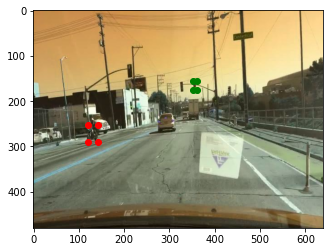

True
0  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
7  vs  1
9  vs  1
7  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
0  vs  1
2  vs  1
0  vs  1
7  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
5  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
7  vs  1
9  vs  1
3  vs  1
9  vs  1
0  vs  1
5  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
7  vs  1
0  vs  1
11  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
10  vs  1
[ 18.820957 153.3737    36.893833 189.91832 ]
(480, 640, 3)


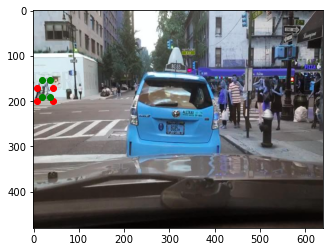

False
2  vs  1
0  vs  1
0  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
26  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
[431.09903 164.70354 459.04962 251.04932]
(480, 640, 3)


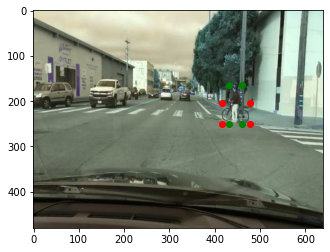

False
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
9  vs  1
5  vs  1
0  vs  1
3  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
11  vs  1
9  vs  1
9  vs  1
0  vs  1
25  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
9  vs  1
25  vs  1
2  vs  1
26  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
[136.00519 187.1631  152.726   239.40361]
(480, 640, 3)


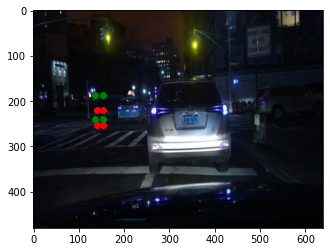

False
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
5  vs  1
5  vs  1
2  vs  1
[ 79.01631 181.61629 120.51222 283.6707 ]
(480, 640, 3)


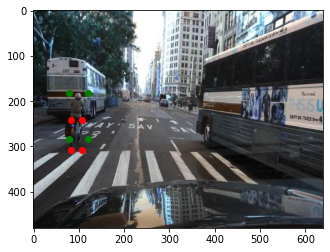

False
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
7  vs  1
9  vs  1
7  vs  1
2  vs  1
12  vs  1
2  vs  1
[583.29956 163.66318 623.21844 276.09982]
(480, 640, 3)


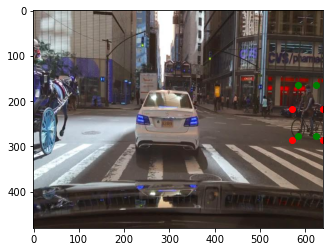

False
0  vs  1
0  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
[1.8353499e-01 1.4682779e+02 3.1517370e+01 2.2139777e+02]
(480, 640, 3)


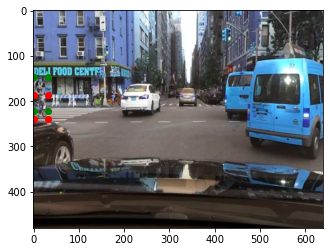

False
2  vs  1
2  vs  1
9  vs  1
5  vs  1
9  vs  1
[167.56721 168.85196 189.7243  209.65155]
(480, 640, 3)


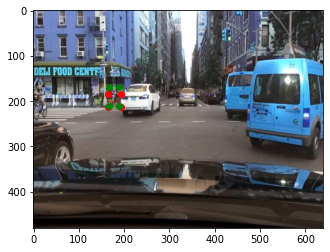

False
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
[117.85973 142.02751 147.74304 221.04968]
(480, 640, 3)


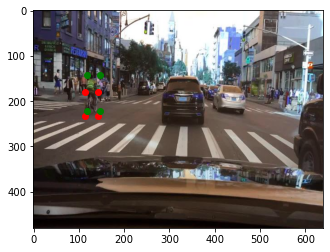

False
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
5  vs  1
2  vs  1
0  vs  1
2  vs  1
3  vs  1
2  vs  1
9  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
9  vs  1
0  vs  1
2  vs  1
[511.21924 223.65501 550.9138  321.3138 ]
(480, 640, 3)


KeyboardInterrupt: ignored

In [12]:
import matplotlib.pyplot as plt

for cls_str, cls_idx in zip(cls_strs[4:], bdd_cls_idxs[4:]):
    print(cls_str)
    print(cls_idx)
    coco = SubCocoDetection(root=root, annFile=annFile, id_shift=id_shift, img_resize=img_size, classes=cls_str) # Object Instance

    train_data = filter_pos_pred(coco, model, id_shift[cls_idx], cfg, n_imgs) # outputs a bunch of images, based on coco api
    
    print("class: {}, n_epochs: {}, Xi: {}, epsilon: {}, number of imgs: {}".format(cls_str, n_epochs, Xi, eps, len(train_data)))

    uap, metric_ls = udos(cfg=cfg, model=model, dataset=train_data, n_epochs=n_epochs, Xi=Xi, epsilon=eps, size=img_size, cls=id_shift[cls_idx])
    metrics = np.array(metric_ls)

    # save list to pickle file
    file_name = 'cls{}_epochs{}_xi{}_eps{}_imgs{}.pkl'.format(cls_str, n_epochs, Xi, eps, len(train_data))
    open_file = open(file_name, "wb")
    pickle.dump(metrics, open_file)
    open_file.close()

['rider']
2
loading annotations into memory...
Done (t=1.52s)
creating index...
index created!
INIT CLASSES:  ['rider']
LENGTH:  527
number of images in ['rider'] = 527
1
filter_pos_pred len dataset:  527


<ipython-input-57-2f8c18da5795>:255: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)


2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
3  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2

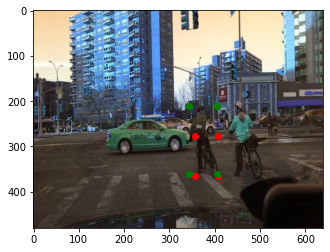

False
2  vs  1
[433.2265  202.12555 494.0395  367.1233 ]
(480, 640, 3)


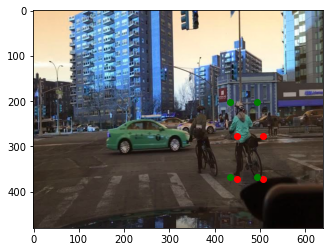

False
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
9  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
[350.51773 203.65707 413.1177  332.1237 ]
(480, 640, 3)


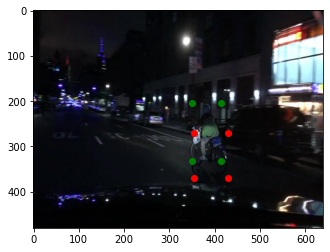

False
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
0  vs  1
3  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[412.38272 211.28635 443.4527  310.10968]
(480, 640, 3)


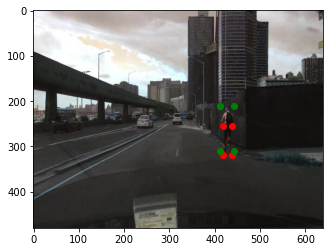

False
2  vs  1
[533.22955 261.67975 555.94684 322.39542]
(480, 640, 3)


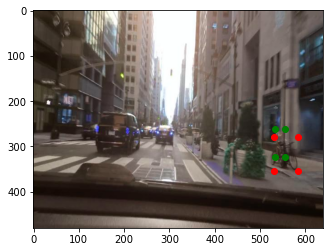

False
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
9  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
7  vs  1
7  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
7  vs  1
9  vs  1
2  vs  1
0  vs  1
5  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
[ 18.820957 153.3737    36.893833 189.91832 ]
(480, 640, 3)


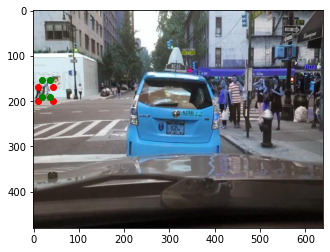

False
0  vs  1
10  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[431.09903 164.70354 459.04962 251.04932]
(480, 640, 3)


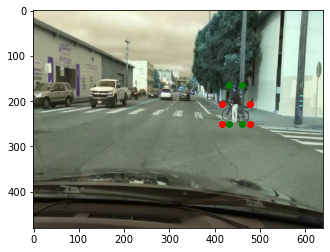

False
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
9  vs  1
5  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
11  vs  1
9  vs  1
9  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
11  vs  1
0  vs  1
0  vs  1
25  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
25  vs  1
9  vs  1
26  vs  1
0  vs  1
0  vs  1
2  vs  1
26  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
5  vs  1
5  vs  1
[ 79.01631 181.61629 120.51222 283.6707 ]
(480, 640, 3)


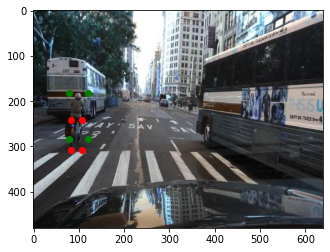

False
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
[583.29956 163.66318 623.21844 276.09982]
(480, 640, 3)


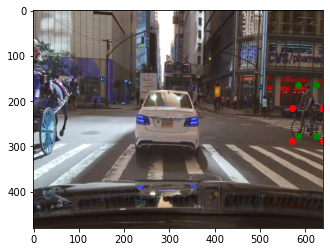

False
0  vs  1
3  vs  1
2  vs  1
9  vs  1
9  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[1.8353499e-01 1.4682779e+02 3.1517370e+01 2.2139777e+02]
(480, 640, 3)


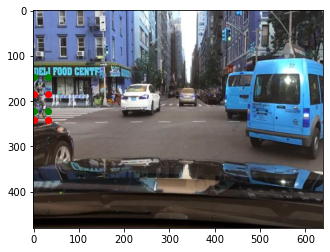

False
2  vs  1
9  vs  1
5  vs  1
9  vs  1
5  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
[117.85973 142.02751 147.74304 221.04968]
(480, 640, 3)


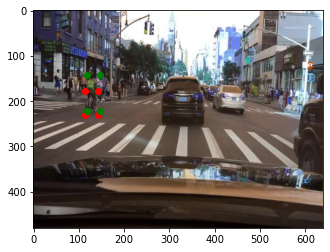

False
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
5  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
3  vs  1
2  vs  1
9  vs  1
9  vs  1
24  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
[511.21924 223.65501 550.9138  321.3138 ]
(480, 640, 3)


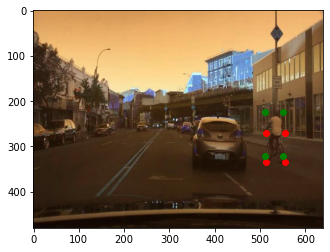

False
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
0  vs  1
2  vs  1
2  vs  1
5  vs  1
9  vs  1
9  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
[557.1222  274.5059  597.0293  358.32507]
(480, 640, 3)


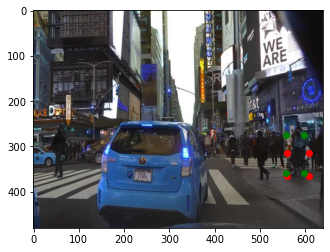

False
0  vs  1
0  vs  1
0  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
[501.98523 324.00006 515.9033  364.1999 ]
(480, 640, 3)


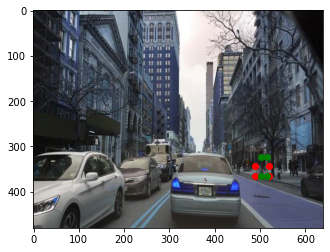

False
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
26  vs  1
0  vs  1
9  vs  1
0  vs  1
0  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[610.055   298.8488  638.98145 361.8702 ]
(480, 640, 3)


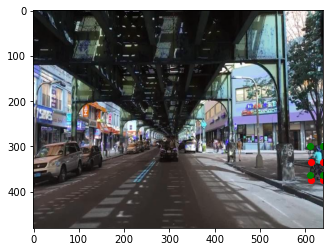

False
0  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
3  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
0  vs  1
[498.69263 243.67177 547.0664  347.18024]
(480, 640, 3)


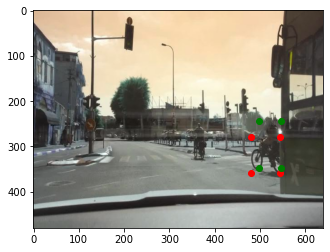

False
5  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
[ 13.616003 229.72484   41.959736 301.26645 ]
(480, 640, 3)


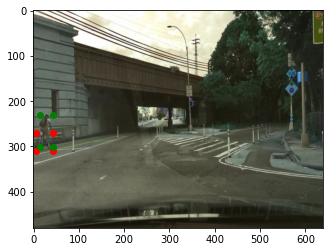

False
9  vs  1
9  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
9  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
[  0.4508405 159.70624    37.55146   331.79324  ]
(480, 640, 3)


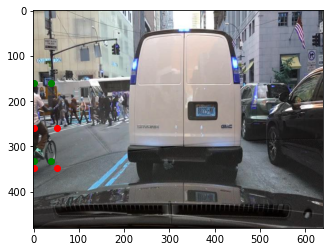

False
0  vs  1
9  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
24  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
9  vs  1
5  vs  1
9  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
13  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
9  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
[563.53265 191.92633 634.0382  352.3493 ]
(480, 640, 3)


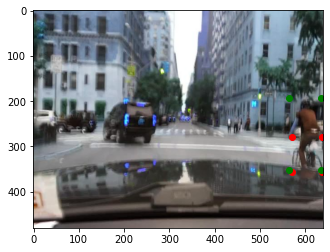

False
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
[555.6007  207.95288 637.39215 367.8433 ]
(480, 640, 3)


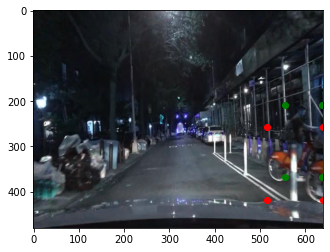

False
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
[107.30685 214.6137  129.64255 285.1546 ]
(480, 640, 3)


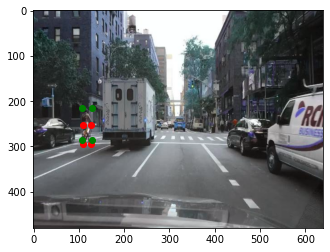

False
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
[231.75565 158.25183 266.61295 246.34122]
(480, 640, 3)


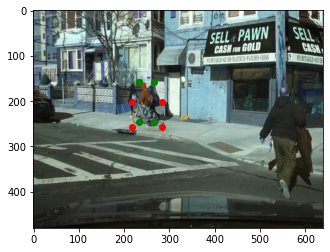

False
0  vs  1
0  vs  1
[ 66.50824 140.68507  90.80917 213.01047]
(480, 640, 3)


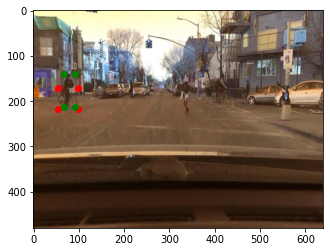

False
2  vs  1
2  vs  1
2  vs  1
[397.41797 138.63768 431.69995 215.05785]
(480, 640, 3)


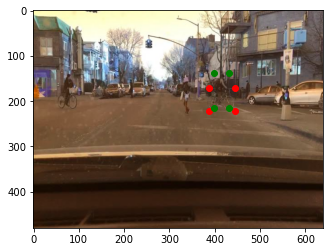

False
2  vs  1
0  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
5  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
[574.8711  142.11412 639.7717  299.53897]
(480, 640, 3)


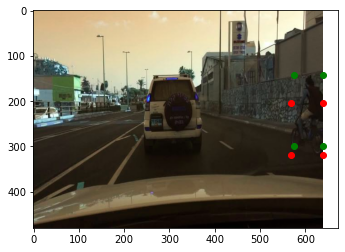

False
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
13  vs  1
0  vs  1
9  vs  1
0  vs  1
7  vs  1
9  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
0  vs  1
[513.4437  186.03873 539.0276  255.68605]
(480, 640, 3)


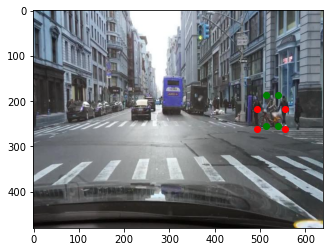

False
2  vs  1
5  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
0  vs  1
2  vs  1
5  vs  1
3  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
[279.3544  152.73076 311.9993  259.52658]
(480, 640, 3)


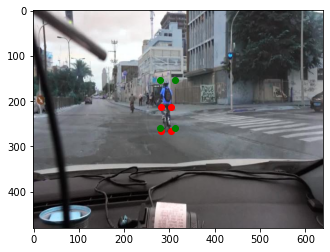

False
0  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
7  vs  1
[611.5432  134.52837 639.1403  263.39658]
(480, 640, 3)


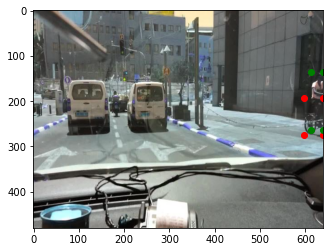

False
9  vs  1
7  vs  1
11  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
3  vs  1
2  vs  1
13  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
13  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
5  vs  1
0  vs  1
2  vs  1
[357.77325 208.11786 402.06708 316.66083]
(480, 640, 3)


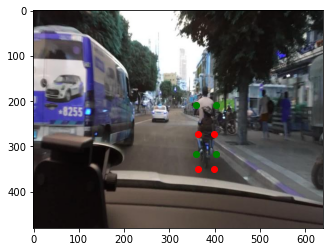

False
9  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
7  vs  1
2  vs  1
[316.41156 178.2     357.19843 262.42456]
(480, 640, 3)


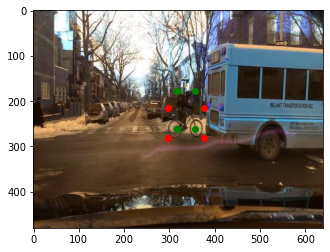

False
2  vs  1
0  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
11  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
6  vs  1
2  vs  1
2  vs  1
2  vs  1
11  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[428.50513 167.58624 474.76907 294.58716]
(480, 640, 3)


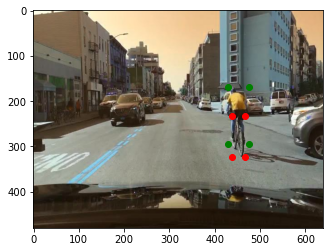

False
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
[ 97.1326  222.78737 132.66771 307.29877]
(480, 640, 3)


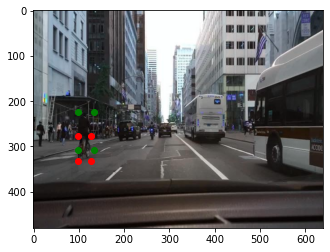

False
3  vs  1
5  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
7  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
5  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
[ 41.79976 329.40707  61.63995 378.32022]
(480, 640, 3)


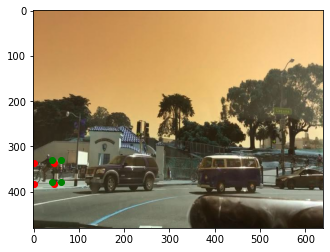

True
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[206.87796 217.72491 242.55374 316.0223 ]
(480, 640, 3)


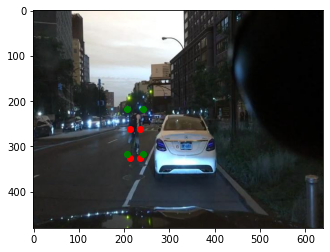

False
9  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
7  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
[113.30538 190.47086 153.13995 303.0225 ]
(480, 640, 3)


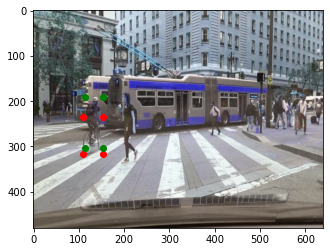

False
0  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
0  vs  1
6  vs  1
0  vs  1
0  vs  1
5  vs  1
2  vs  1
0  vs  1
[480.37225 231.70506 502.89334 293.1431 ]
(480, 640, 3)


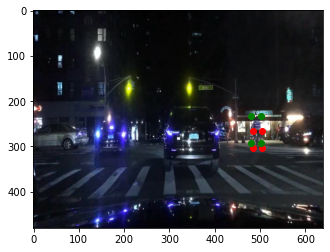

False
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
3  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
5  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
5  vs  1
0  vs  1
[ 39.333035 166.10555   67.29066  250.97

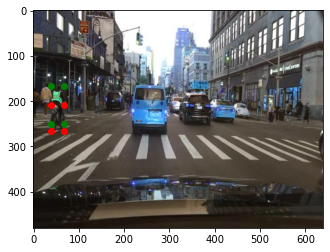

False
2  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
0  vs  1
0  vs  1
[554.6634  182.95618 597.2579  262.19925]
(480, 640, 3)


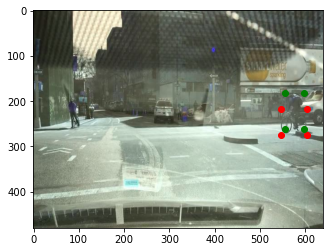

False
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
[101.90324 121.82663 138.16736 237.46106]
(480, 640, 3)


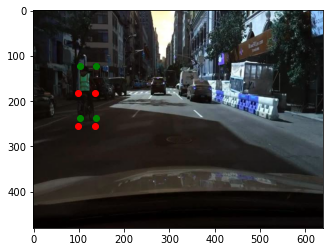

False
2  vs  1
0  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
3  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
3  vs  1
0  vs  1
0  vs  1
[371.47986 179.27438 394.76108 257.566  ]
(480, 640, 3)


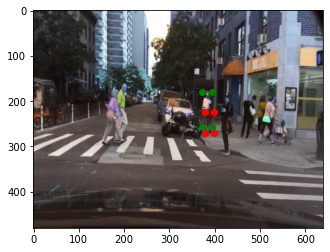

False
0  vs  1
[ 31.448843 171.39938   59.792572 254.191   ]
(480, 640, 3)


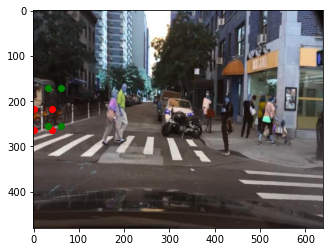

False
2  vs  1
26  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
0  vs  1
5  vs  1
0  vs  1
5  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[509.08365 197.97697 528.3     261.03134]
(480, 640, 3)


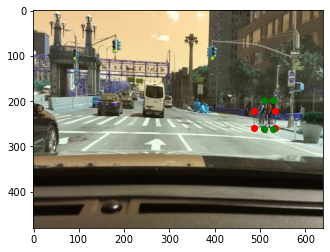

False
9  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
9  vs  1
7  vs  1
58  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
5  vs  1
3  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
5  vs  1
2  vs  1
3  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
[567.13556 279.05423 613.7019  389.67114]
(480, 640, 3)


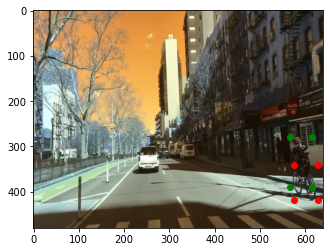

False
9  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
5  vs  1
[609.3031  128.47491 640.1781  313.64145]
(480, 640, 3)


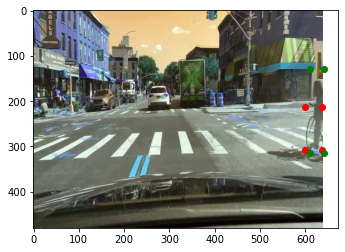

False
2  vs  1
[526.59265 176.24478 569.7907  270.3746 ]
(480, 640, 3)


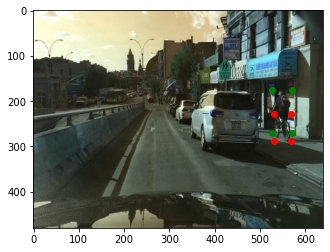

False
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
0  vs  1
2  vs  1
5  vs  1
2  vs  1
7  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
9  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
[184.04372 173.0219  256.28958 342.55127]
(480, 640, 3)


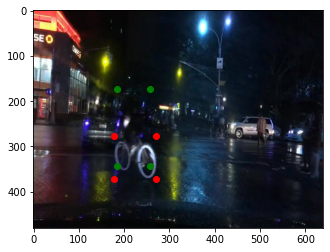

False
9  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
9  vs  1
[522.7575  222.87466 562.6764  343.96017]
(480, 640, 3)


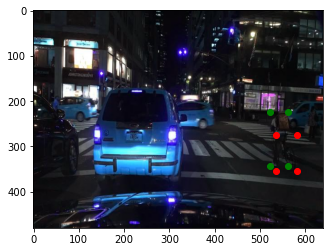

False
0  vs  1
2  vs  1
7  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
[463.58905 203.19373 492.26297 278.1371 ]
(480, 640, 3)


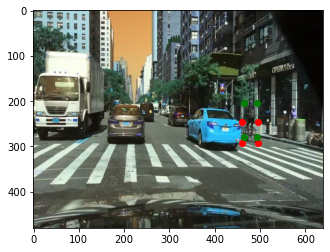

False
0  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
61  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
9  vs  1
7  vs  1
9  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
[  6.2767544 153.03326    30.987095  219.4564   ]
(480, 640, 3)


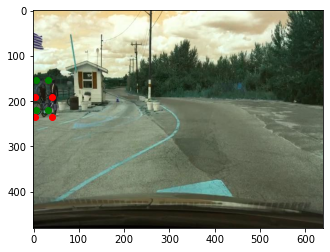

False
0  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
7  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
0  vs  1
[556.14685 198.22485 596.3031  313.64145]
(480, 640, 3)


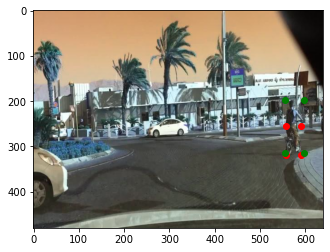

False
2  vs  1
[ 43.990982 213.97485   57.147224 232.64151 ]
(480, 640, 3)


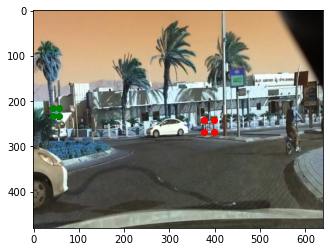

False
2  vs  1
2  vs  1
0  vs  1
2  vs  1
10  vs  1
2  vs  1
7  vs  1
5  vs  1
0  vs  1
[440.8314  225.33203 462.84036 274.47922]
(480, 640, 3)


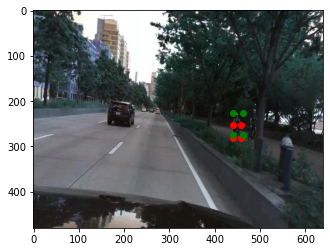

False
10  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
[471.31088 156.12436 549.87305 326.90503]
(480, 640, 3)


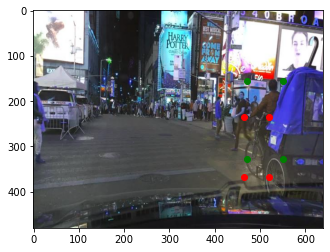

False
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
[463.0395  155.31595 519.4104  194.76059]
(480, 640, 3)


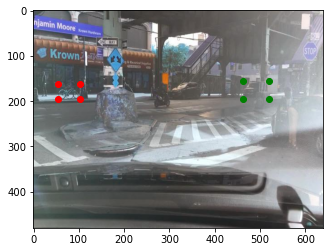

False
2  vs  1
3  vs  1
2  vs  1
[114.637794 156.61783  151.46667  268.15485 ]
(480, 640, 3)


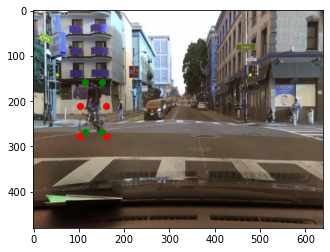

False
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
5  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
2  vs  1
5  vs  1
2  vs  1
9  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
[156.61783 217.43506 194.25401 325.74286]
(480, 640, 3)


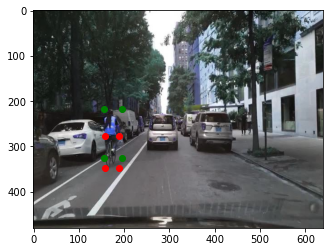

False
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
[  0.      111.59992  52.92848 368.76642]
(480, 640, 3)


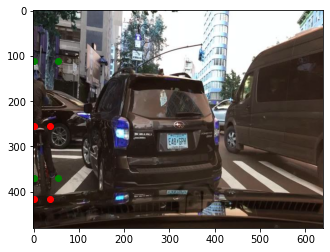

False
0  vs  1
5  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
[605.5659  184.04944 623.28937 200.69147]
(480, 640, 3)


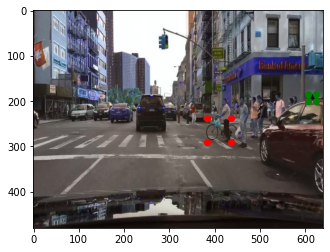

False
2  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
25  vs  1
0  vs  1
9  vs  1
0  vs  1
0  vs  1
9  vs  1
26  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
7  vs  1
9  vs  1
2  vs  1
9  vs  1
[  3.8267725 107.659874   54.074818  219.55806  ]
(480, 640, 3)


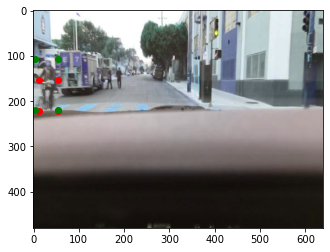

False
2  vs  1
2  vs  1
5  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
[578.1083  246.41989 613.0551  323.968  ]
(480, 640, 3)


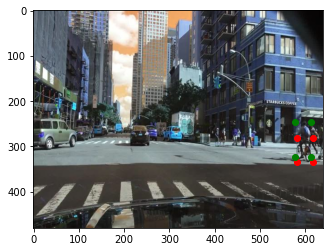

False
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[404.13443 159.75359 453.30936 291.2185 ]
(480, 640, 3)


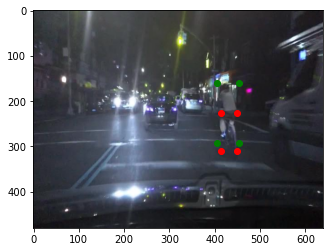

False
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
5  vs  1
2  vs  1
5  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[129.14255 169.14    161.21582 260.4296 ]
(480, 640, 3)


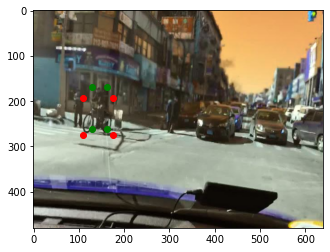

False
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
0  vs  1
0  vs  1
0  vs  1
26  vs  1
[226.5338  101.12521 266.45267 235.51668]
(480, 640, 3)


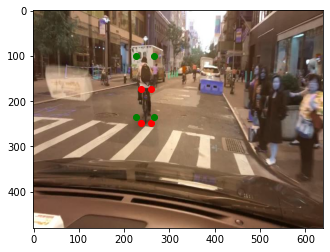

False
0  vs  1
5  vs  1
0  vs  1
0  vs  1
5  vs  1
2  vs  1
0  vs  1
0  vs  1
[390.43304 201.89694 420.62378 281.7389 ]
(480, 640, 3)


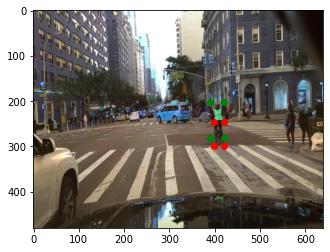

False
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
3  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
5  vs  1
0  vs  1
0  vs  1
5  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
[295.81622 207.1401  320.286   281.87448]
(480, 640, 3)


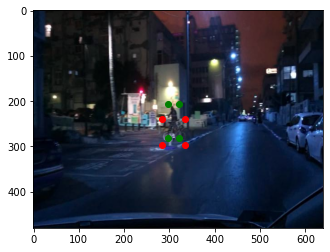

False
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
[106.97535 158.61862 152.66321 279.17145]
(480, 640, 3)


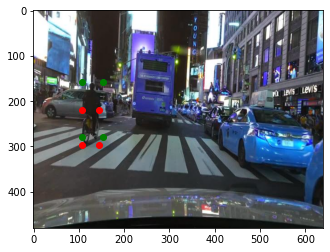

False
2  vs  1
2  vs  1
0  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
[435.84882 254.57162 445.96393 306.51892]
(480, 640, 3)


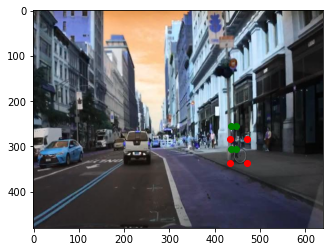

False
0  vs  1
7  vs  1
7  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
9  vs  1
9  vs  1
9  vs  1
9  vs  1
9  vs  1
7  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[346.4734   94.85369 391.1552  210.34325]
(480, 640, 3)


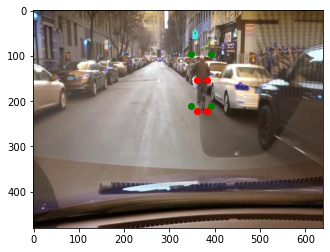

False
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
7  vs  1
[305.5533  159.97488 310.27206 174.14154]
(480, 640, 3)


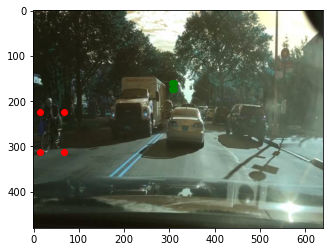

True
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
5  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
0  vs  1
0  vs  1
0  vs  1
5  vs  1
[368.71133 203.79982 392.91864 278.4999 ]
(480, 640, 3)


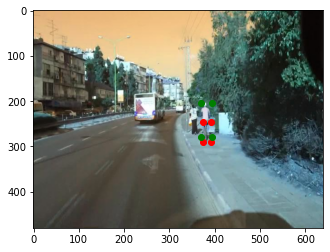

False
2  vs  1
2  vs  1
0  vs  1
36  vs  1
0  vs  1
28  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
7  vs  1
9  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
10  vs  1
0  vs  1
5  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
7  vs  1
2  vs  1
0  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
0  vs  1
11  vs  1
9  vs  1
2  vs  1
9  vs  1
7  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
[560.22565 250.12305 640.5     456.5526 ]
(48

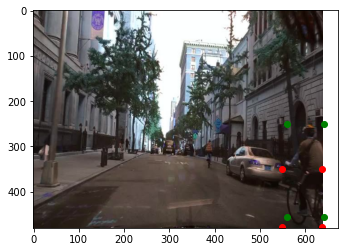

False
0  vs  1
0  vs  1
2  vs  1
0  vs  1
[ 28.240347 162.40814  102.19127  341.8054  ]
(480, 640, 3)


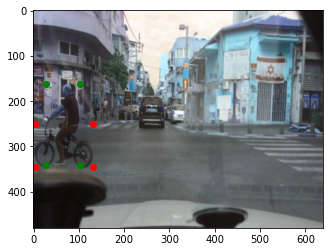

False
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
10  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
3  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
7  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
[565.85645 237.9051  593.18317 302.62314]
(480, 640, 3)


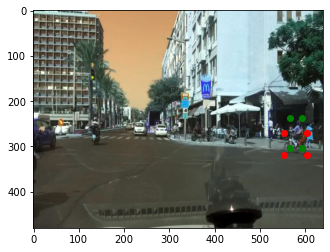

False
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
[126.023155 126.43908  135.88132  155.38817 ]
(480, 640, 3)


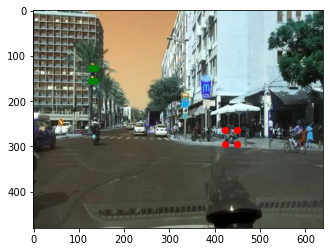

False
0  vs  1
0  vs  1
3  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
7  vs  1
5  vs  1
9  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
3  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
9  v

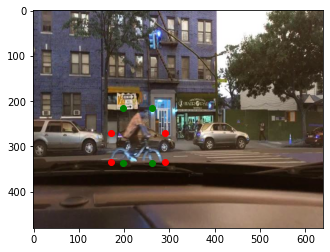

False
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
[ 98.57257  133.9256   120.284386 142.91063 ]
(480, 640, 3)


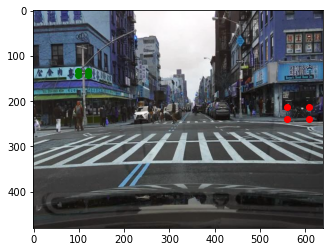

False
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
3  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
3  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
7  vs  1
[496.6061  171.35822 545.14465 308.44598]
(480, 640, 3)


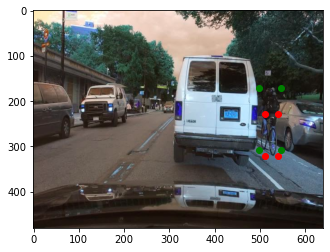

False
2  vs  1
2  vs  1
0  vs  1
[  0.       138.5999    47.022232 345.14142 ]
(480, 640, 3)


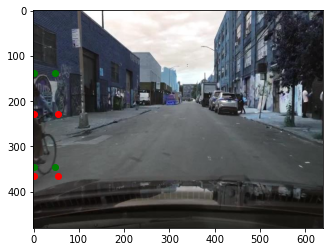

False
0  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
10  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
9  vs  1
9  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
62  vs  1
9  vs  1
56  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
62  vs  1
0  vs  1
0  vs  1
0  vs  1
[427.9819  254.08421 450.56158 312.34625]
(480, 640, 3)


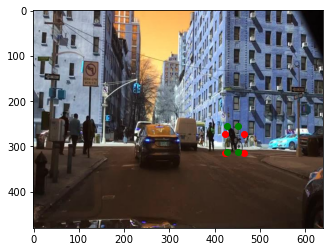

False
2  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
7  vs  1
0  vs  1
58  vs  1
2  vs  1
58  vs  1
[545.73615 238.60132 595.8017  377.45074]
(480, 640, 3)


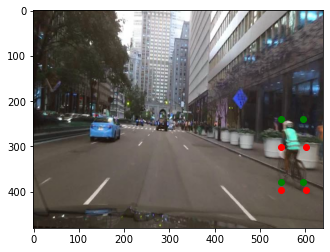

False
2  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
11  vs  1
40  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
56  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
0  vs  1
7  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
[578.71326 234.91281 639.7248  383.54803]
(480, 640, 3)


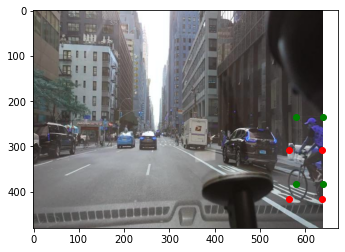

False
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
7  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
[150.97824 213.78186 176.43332 285.1546 ]
(480, 640, 3)


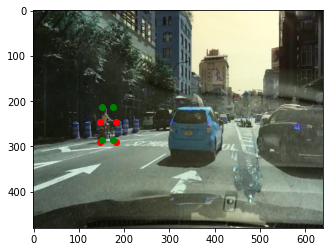

False
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
0  vs  1
[434.33835 245.30437 487.69635 390.18854]
(480, 640, 3)


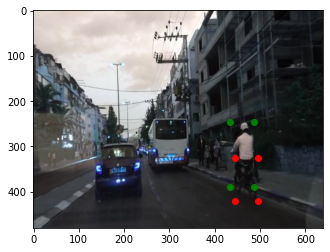

False
0  vs  1
5  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
[385.1736  227.26051 412.54562 301.6333 ]
(480, 640, 3)


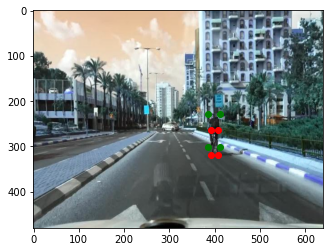

False
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
9  vs  1
0  vs  1
0  vs  1
3  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
7  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
10  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[530.72174 216.74231 560.9125  297.57394]
(480, 640, 3)


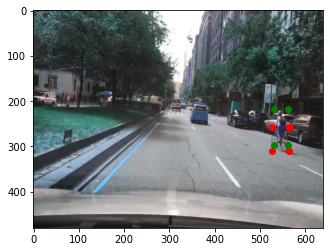

False
0  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
3  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
9  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
3  vs  1
9  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
0  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  v

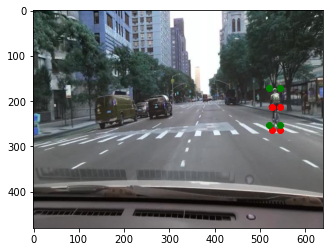

False
0  vs  1
2  vs  1
2  vs  1
9  vs  1
7  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
0  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
2  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
[502.221   182.17209 543.273   258.53583]
(480, 640, 3)


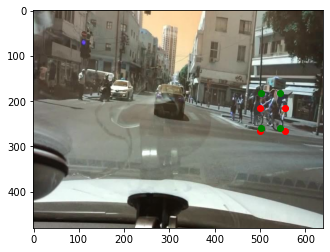

False
0  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[ 88.163246 201.59996  136.93262  341.56454 ]
(480, 640, 3)


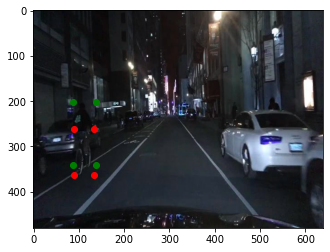

True
2  vs  1
7  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
5  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
3  vs  1
5  vs  1
[255.56322 237.15913 304.9938  402.69107]
(480, 640, 3)


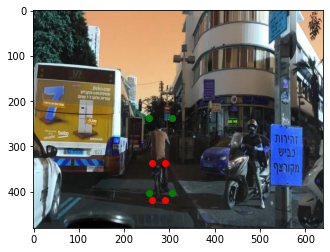

False
2  vs  1
2  vs  1
5  vs  1
0  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
5  vs  1
0  vs  1
0  vs  1
5  vs  1
5  vs  1
0  vs  1
[348.84436   78.716225 367.9135   131.46196 ]
(480, 640, 3)


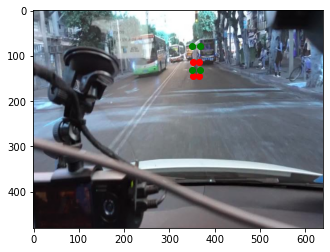

False
[358.4491      5.2932787 364.71194    25.596313 ]
(480, 640, 3)


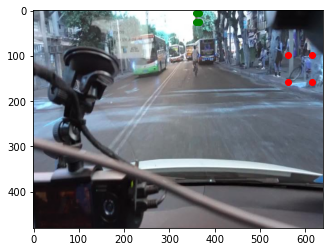

False
5  vs  1
0  vs  1
3  vs  1
11  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
7  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
[533.5708  163.24782 571.5034  237.11606]
(480, 640, 3)


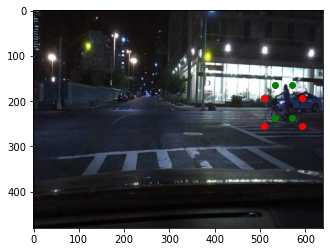

False
2  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
0  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
[547.10706 203.94131 583.5479  310.56686]
(480, 640, 3)


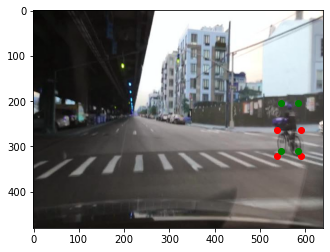

False
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
9  vs  1
9  vs  1
9  vs  1
0  vs  1
0  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
[505.3404  197.97697 533.29095 260.1995 ]
(480, 640, 3)


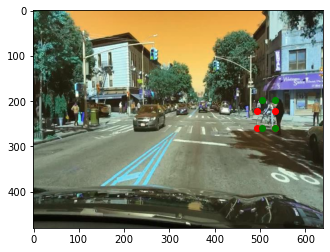

False
9  vs  1
9  vs  1
2  vs  1
0  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
3  vs  1
7  vs  1
2  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
0  vs  1
7  vs  1
2  vs  1
2  vs  1
0  vs  1
2  vs  1
9  vs  1
9  vs  1
5  vs  1
0  vs  1
2  vs  1
2  vs  1
2  vs  1
[343.17545 340.53055 356.2387  354.4217 ]
(480, 640, 3)


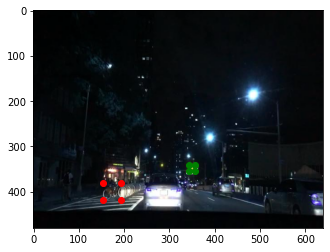

False
9  vs  1
0  vs  1
9  vs  1
0  vs  1
3  vs  1
9  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
0  vs  1
0  vs  1
0  vs  1
2  vs  1
9  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
7  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
0  vs  1
3  vs  1
2  vs  1
9  vs  1
9  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
2  vs  1
ground truth # of classes for filtered images: 11, predicted # of classes for filtered images: 3
number of filtered images: 3


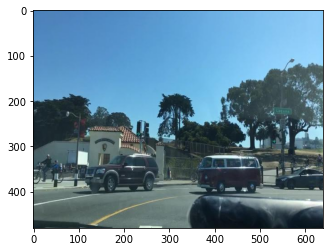

In [ ]:
# Sampling filtered images of each category

import matplotlib.pyplot as plt

for cls_str, cls_idx in zip(cls_strs, bdd_cls_idxs):
    cls_str = cls_strs[4]
    cls_idx = bdd_cls_idxs[4]

    print(cls_str)
    print(cls_idx)
    coco = SubCocoDetection(root=root, annFile=annFile, id_shift=id_shift, img_resize=img_size, classes=cls_str) # Object Instance

    print(id_shift[cls_idx])
    train_data = filter_pos_pred(coco, model, id_shift[cls_idx], cfg, n_imgs) # outputs a bunch of images, based on coco api

    for i in [0, 100, 200, 300 , 400]:
      if i < len(train_data):
        img, data = train_data[i]
        plt.imshow(img)
        plt.show()

        img.save('E:/Summer2021Research/bdd100k/100k/sample_images/Bdd_'+cls_str[0]+'_'+str(i)+'.jpg')

    break




In [ ]:
annFile = 'E:/Summer2021Research/bdd100k/bdd100k/labels/det_20/det_val_coco.json'
coco = COCO(annFile)
coco.loadCats(coco.getCatIds())

loading annotations into memory...
Done (t=1.14s)
creating index...
index created!


[{'id': 1, 'name': 'pedestrian'},
 {'id': 2, 'name': 'rider'},
 {'id': 3, 'name': 'car'},
 {'id': 4, 'name': 'truck'},
 {'id': 5, 'name': 'bus'},
 {'id': 6, 'name': 'train'},
 {'id': 7, 'name': 'motorcycle'},
 {'id': 8, 'name': 'bicycle'},
 {'id': 9, 'name': 'traffic light'},
 {'id': 10, 'name': 'traffic sign'}]

### **Kitti Main**

In [ ]:
import os

class SubKittiDetection(torch.utils.data.Dataset):
    """

    Args:
    root (string): Root directory where images are downloaded to.
    classes (string array): Names of categories we want in NuImages format
    img_resize (int 2-tuple): image's current resized size

    transform (callable, optional): A function/transform that  takes in an PIL image and returns a transformed version. E.g, ``transforms.ToTensor``
    target_transform (callable, optional): A function/transform that takes in the target and transforms it.
    transforms (callable, optional): A function/transform that takes input sample and its target as entry and returns a transformed version.
    """

    def __init__(self, root, category, model, to_coco, cfg, max_img, img_resize=None, transform=None, target_transform=None, transforms=None):
        self.root = root
        self.transforms = transforms
        self.category = category

        self.img_resize = img_resize
        self.to_coco = to_coco
    
        annfiles = []


        cat_to_count = dict()

        for file_str in os.listdir(root + '/label_2'):
          path = os.path.join(root + '/label_2', file_str)
          with open(path, 'r') as annfile:
            if category in annfile.read():
              annfiles.append(file_str)

            # Counting labels

            # lines = annfile.readlines()
            # for line in lines:
            #   line = line.split(' ')
            #   cat = line[0]
            #   cat_to_count[cat] = cat_to_count[cat] + 1 if cat in cat_to_count else 1

        # for k,v in cat_to_count.items():
        #   print(k, ' : ', v)
         
        self.annfiles = annfiles

        self.filter_pos(model, to_coco[category], cfg, max_img)

    def __getitem__(self, index):
        """
        Args:
            index (int): index

        Returns:
            img, target (tuple): target is the object returned by ``coco.loadAnns``.
        """

        ann_str = self.annfiles[index]
        img_str = ann_str[:-4] + '.png'

        img = Image.open(os.path.join(self.root+'/image_2', img_str)).convert('RGB') # open the PIL image

        boxes = []
        labels = []
        num_objs = 0

        with open(os.path.join(self.root + '/label_2', ann_str), 'r') as ann_file:
          lines = ann_file.readlines()
          num_objs = len(lines)
          for line in lines:
            line = line.split(' ')
            cat = line[0]
            labels.append(self.to_coco[cat])

            bbox = [float(n) for n in line[4:8]]
            xmin, ymin, xmax, ymax = bbox
            x_resize = self.img_resize[0] / 1242
            y_resize = self.img_resize[1] / 375
            boxes.append([(xmin*x_resize), (ymin*y_resize), (xmax*x_resize), (ymax*y_resize)])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["iscrowd"] = iscrowd

        # preprocess image if wanted
        if self.transforms is not None:
            img = self.transforms(img)
            
        return img, target

    def __len__(self):
        return len(self.annfiles)

    def filter_pos(self, model, cls, cfg, max_img):
      """ to completely isolate the effect of the perturbation, we have to only use the images that the detector results in correct prediction
      
      returns: 
          - train_data: list[tuple], images that have at least one correct prediction of our target class

      params:
          - dataset: the dataset that we want to filter out
          - model: the object detector we want to test on
          - cls: the target class that we are interested in
          - cfg: config file that contains class category strings for COCO2017 train
          - max_img: max number of images that we want to keep as training data
      """

      # split into train and val data
      train_data = []
      gt_total_count = 0
      pred_total_count = 0
      img_num = 0

      for i in range(len(self.annfiles)):
          is_correct, gt_count, pred_count = is_pos_pred(self[i], model, cls, cfg) # dataset[i]=Pil Object
          
          if is_correct is True:
            train_data.append(self.annfiles[i])
            img_num += 1
            gt_total_count += gt_count
            pred_total_count += pred_count

            # finish if collected images exceed the desired number of training examples
            if img_num >= max_img:
                break
            
      print('ground truth # of classes for filtered images: {}, predicted # of classes for filtered images: {}'.format(gt_total_count, pred_total_count))
      print('number of filtered images: {}'.format(len(train_data)))
      self.annfiles = train_data


In [ ]:
# %cd E:/Summer2021Research/Kitti/training
%cd E:/Summer2021Research/mask_rcnn/kitti

faster_rcnn = "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"
mask_rcnn =  "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
config_file = mask_rcnn

root = 'E:/Summer2021Research/Kitti/training'
n_epochs = 250
Xi = 10 # [10, 15, 20]
eps = 20 # [1, 5, 10, 20, 30] 
n_imgs = 500
score_thresh = 0.7
iou_thresh = 0.5

img_size = (640, 375)
to_coco = {'Car':2, 'Truck':7, 'Pedestrian':0, 'Van':-1, 'Person_sitting':0, 'Cyclist':1, 'Tram':-1, 'Misc':-1, 'DontCare':-1}
model, cfg = get_detector(config_file, score_thresh, data_type='model')

# person=0, bicycle=1, car=2, motorcycle=3, bus=5, truck=7, traffic light=9, stop sign=11
cls_strs = [['Pedestrian'], ['Car'], ['Truck'], ['Cyclist']]
cls_idxs = [0, 2, 7, 1]

for cls_str, cls_idx in zip(cls_strs[1:], cls_idxs[1:]):
    kitti = SubKittiDetection(root=root, category=cls_str[0], model=model, to_coco=to_coco, cfg=config_file, max_img=n_imgs, img_resize=img_size) # Object Instance
    #kitt.annfiles = filter_pos(model, to_coco[category], config_file, max_img)
    dataset_name = "kitti_{}".format(cls_str)
    
    print("class: {}, n_epochs: {}, Xi: {}, epsilon: {}, number of imgs: {}".format(cls_str, n_epochs, Xi, eps, len(kitti)))

    uap, metric_ls = udos(cfg=cfg, model=model, dataset=kitti, n_epochs=n_epochs, Xi=Xi, epsilon=eps, size=img_size, cls=cls_idx)
    metrics = np.array(metric_ls)

    # save list to pickle file
    file_name = 'cls{}_epochs{}_xi{}_eps{}_imgs{}.pkl'.format(cls_str, n_epochs, Xi, eps, len(kitti))
    open_file = open(file_name, "wb")
    pickle.dump(metrics, open_file)
    open_file.close()

E:\Summer2021Research\mask_rcnn\kitti


The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}
<ipython-input-3-3d6a597a5ce8>:255: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)


ground truth # of classes for filtered images: 2364, predicted # of classes for filtered images: 1623
number of filtered images: 500
class: ['Car'], n_epochs: 250, Xi: 10, epsilon: 20, number of imgs: 500
epoch 1
loss: 2.6054063092470168, perturbation l1-norm: 0.003198449732735753, instance_level_blind_deg: 2.603635787963867, img_level_blind_deg: 0.898
epoch 2
loss: 2.595244730234146, perturbation l1-norm: 0.009606222622096539, instance_level_blind_deg: 2.589301824569702, img_level_blind_deg: 0.896
epoch 3
loss: 2.57311961376667, perturbation l1-norm: 0.01878991723060608, instance_level_blind_deg: 2.5602970123291016, img_level_blind_deg: 0.892
epoch 4
loss: 2.549491000652313, perturbation l1-norm: 0.03045819140970707, instance_level_blind_deg: 2.5278894901275635, img_level_blind_deg: 0.88
epoch 5
loss: 2.5137995295524598, perturbation l1-norm: 0.04453553631901741, instance_level_blind_deg: 2.4810895919799805, img_level_blind_deg: 0.876
epoch 6
loss: 2.483548871040344, perturbation l1-n

In [ ]:
# saving sample images

%cd E:/Summer2021Research/Kitti/training

config_file = "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"
root = 'E:/Summer2021Research/Kitti/training'
n_epochs = 250
Xi = 10 # [10, 15, 20]
eps = 20 # [1, 5, 10, 20, 30] 
n_imgs = 500
score_thresh = 0.7
iou_thresh = 0.5

img_size = (640, 375)
to_coco = {'Car':2, 'Truck':7, 'Pedestrian':0, 'Van':-1, 'Person_sitting':0, 'Cyclist':1, 'Tram':-1, 'Misc':-1, 'DontCare':-1}
model, cfg = get_detector(config_file, score_thresh, data_type='model')

# person=0, bicycle=1, car=2, motorcycle=3, bus=5, truck=7, traffic light=9, stop sign=11
cls_strs = [['Pedestrian'], ['Car'], ['Truck'], ['Cyclist']]
cls_idxs = [0, 2, 7, 1]

for cls_str, cls_idx in zip(cls_strs, cls_idxs):
    kitti = SubKittiDetection(root=root, category=cls_str[0], model=model, to_coco=to_coco, cfg=config_file, max_img=n_imgs, img_resize=img_size) # Object Instance

E:\Summer2021Research\Kitti\training


The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


Pedestrian  :  4487
Truck  :  1094
Car  :  28742
Cyclist  :  1627
DontCare  :  11295
Misc  :  973
Van  :  2914
Tram  :  511
Person_sitting  :  222
ground truth # of classes for filtered images: 0, predicted # of classes for filtered images: 0
number of filtered images: 0
Pedestrian  :  4487
Truck  :  1094
Car  :  28742
Cyclist  :  1627
DontCare  :  11295
Misc  :  973
Van  :  2914
Tram  :  511
Person_sitting  :  222
ground truth # of classes for filtered images: 0, predicted # of classes for filtered images: 0
number of filtered images: 0
Pedestrian  :  4487
Truck  :  1094
Car  :  28742
Cyclist  :  1627
DontCare  :  11295
Misc  :  973
Van  :  2914
Tram  :  511
Person_sitting  :  222
ground truth # of classes for filtered images: 0, predicted # of classes for filtered images: 0
number of filtered images: 0
Pedestrian  :  4487
Truck  :  1094
Car  :  28742
Cyclist  :  1627
DontCare  :  11295
Misc  :  973
Van  :  2914
Tram  :  511
Person_sitting  :  222
ground truth # of classes for filtere

**Udacity Main**

In [ ]:
# %cd E:\\Summer2021Research\\Udacity
%cd E:\\Summer2021Research\\mask_rcnn\\udacity

faster_rcnn = "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"
mask_rcnn =  "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
config_file = mask_rcnn

root = 'E:/Summer2021Research/Udacity/export'
annFile = 'E:/Summer2021Research/Udacity/_annotations.coco.json'
n_epochs = 250
Xi = 10 # [10, 15, 20]
eps = 20 # [1, 5, 10, 20, 30] 
n_imgs = 500
score_thresh = 0.7
iou_thresh = 0.5

img_size = (640, 480)
id_shift = {0:-1, 1:1, 2:2, 3:0, 4:9, 5:9, 6:9, 7:9, 8:9, 9:9, 10:9, 11:7}
model, cfg = get_detector(config_file, score_thresh, data_type='model')

# person=0, bicycle=1, car=2, motorcycle=3, bus=5, truck=7, traffic light=9, stop sign=11
cls_strs = [['pedestrian'], ['car'], ['truck'], ['trafficLight'], ['biker']]
cls_idxs = [0, 2, 7, 9, 1]
cls_idxs = [3,2,11,4, 1]

E:\Summer2021Research\mask_rcnn\udacity


The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


In [ ]:
coco = COCO(annFile)
print(coco.cats)

loading annotations into memory...
Done (t=119.92s)
creating index...
index created!
{0: {'id': 0, 'name': 'obstacles', 'supercategory': 'none'}, 1: {'id': 1, 'name': 'biker', 'supercategory': 'obstacles'}, 2: {'id': 2, 'name': 'car', 'supercategory': 'obstacles'}, 3: {'id': 3, 'name': 'pedestrian', 'supercategory': 'obstacles'}, 4: {'id': 4, 'name': 'trafficLight', 'supercategory': 'obstacles'}, 5: {'id': 5, 'name': 'trafficLight-Green', 'supercategory': 'obstacles'}, 6: {'id': 6, 'name': 'trafficLight-GreenLeft', 'supercategory': 'obstacles'}, 7: {'id': 7, 'name': 'trafficLight-Red', 'supercategory': 'obstacles'}, 8: {'id': 8, 'name': 'trafficLight-RedLeft', 'supercategory': 'obstacles'}, 9: {'id': 9, 'name': 'trafficLight-Yellow', 'supercategory': 'obstacles'}, 10: {'id': 10, 'name': 'trafficLight-YellowLeft', 'supercategory': 'obstacles'}, 11: {'id': 11, 'name': 'truck', 'supercategory': 'obstacles'}}


In [ ]:
for cls_str, cls_idx in zip(cls_strs, cls_idxs):

    coco = SubCocoDetection(root=root, annFile=annFile, id_shift=id_shift, img_resize=img_size, classes=cls_str) # Object Instance

    train_data = filter_pos_pred(coco, model, id_shift[cls_idx], cfg, n_imgs) # outputs a bunch of images, based on coco api
    
    print("class: {}, n_epochs: {}, Xi: {}, epsilon: {}, number of imgs: {}".format(cls_str, n_epochs, Xi, eps, len(train_data)))

    uap, metric_ls = udos(cfg=cfg, model=model, dataset=train_data, n_epochs=n_epochs, Xi=Xi, epsilon=eps, size=img_size, cls=id_shift[cls_idx])
    metrics = np.array(metric_ls)

    # save list to pickle file
    file_name = 'cls{}_epochs{}_xi{}_eps{}_imgs{}.pkl'.format(cls_str, n_epochs, Xi, eps, len(train_data))
    open_file = open(file_name, "wb")
    pickle.dump(metrics, open_file)
    open_file.close()

loading annotations into memory...
Done (t=3.44s)
creating index...
index created!
INIT CLASSES:  ['pedestrian']
LENGTH:  7070
number of images in ['pedestrian'] = 7070
filter_pos_pred len dataset:  7070


<ipython-input-3-3d6a597a5ce8>:255: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)


ground truth # of classes for filtered images: 2161, predicted # of classes for filtered images: 1081
number of filtered images: 500
class: ['pedestrian'], n_epochs: 250, Xi: 10, epsilon: 20, number of imgs: 500
epoch 1
loss: 2.1639183712005616, perturbation l1-norm: 0.002467204350978136, instance_level_blind_deg: 2.162574052810669, img_level_blind_deg: 0.942
epoch 2
loss: 2.1433563576936723, perturbation l1-norm: 0.007082047872245312, instance_level_blind_deg: 2.138850212097168, img_level_blind_deg: 0.936
epoch 3
loss: 2.1022659473419187, perturbation l1-norm: 0.013364416547119617, instance_level_blind_deg: 2.0928568840026855, img_level_blind_deg: 0.924
epoch 4
loss: 2.0708450405597687, perturbation l1-norm: 0.02087586373090744, instance_level_blind_deg: 2.0552587509155273, img_level_blind_deg: 0.912
epoch 5
loss: 2.0283381271362306, perturbation l1-norm: 0.02948543056845665, instance_level_blind_deg: 2.0059423446655273, img_level_blind_deg: 0.892
epoch 6
loss: 1.9860847558975219, per

loading annotations into memory...
Done (t=1.69s)
creating index...
index created!
INIT CLASSES:  ['pedestrian']
LENGTH:  7070
number of images in ['pedestrian'] = 7070
filter_pos_pred len dataset:  7070


<ipython-input-3-07b0ff892883>:255: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)


ground truth # of classes for filtered images: 2187, predicted # of classes for filtered images: 1074
number of filtered images: 500


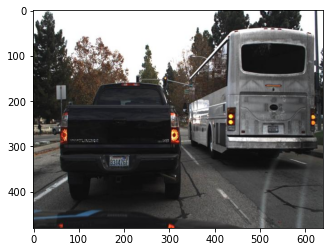

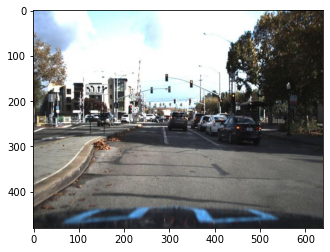

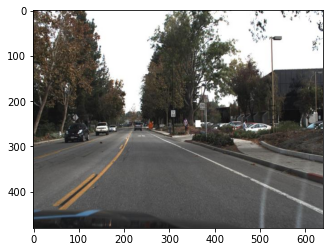

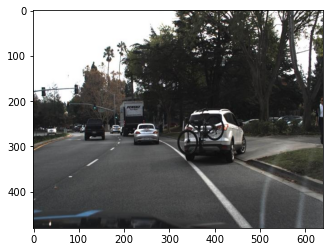

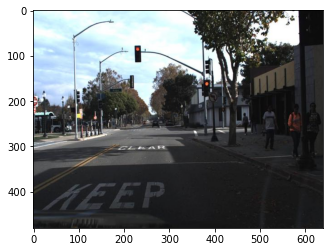

loading annotations into memory...
Done (t=1.29s)
creating index...
index created!
INIT CLASSES:  ['car']
LENGTH:  25924
number of images in ['car'] = 25924
filter_pos_pred len dataset:  25924
ground truth # of classes for filtered images: 2600, predicted # of classes for filtered images: 1634
number of filtered images: 500


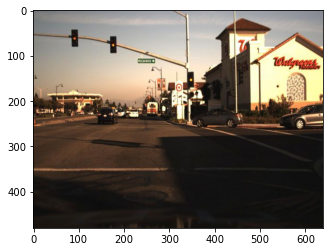

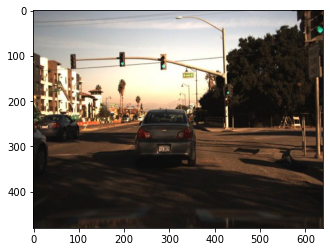

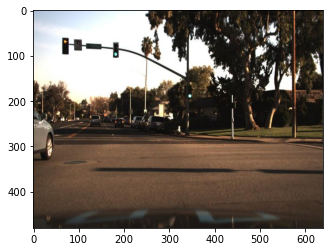

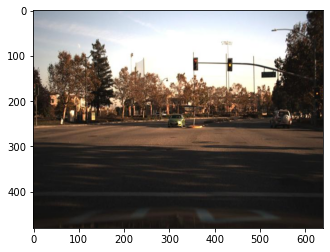

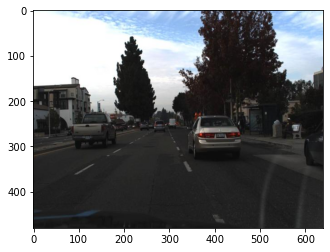

loading annotations into memory...
Done (t=1.37s)
creating index...
index created!
INIT CLASSES:  ['truck']
LENGTH:  5058
number of images in ['truck'] = 5058
filter_pos_pred len dataset:  5058
ground truth # of classes for filtered images: 786, predicted # of classes for filtered images: 529
number of filtered images: 500


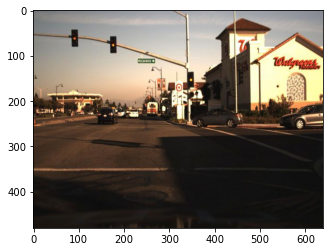

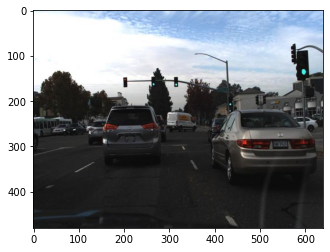

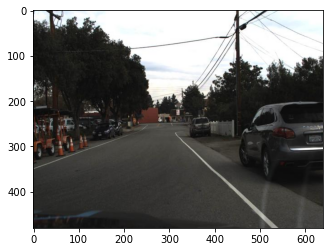

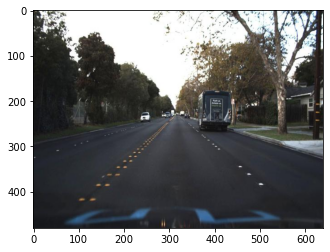

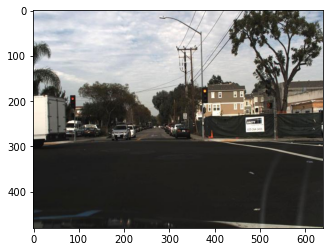

loading annotations into memory...
Done (t=1.21s)
creating index...
index created!
INIT CLASSES:  ['trafficLight']
LENGTH:  3198
number of images in ['trafficLight'] = 3198
filter_pos_pred len dataset:  3198
ground truth # of classes for filtered images: 2097, predicted # of classes for filtered images: 1075
number of filtered images: 500


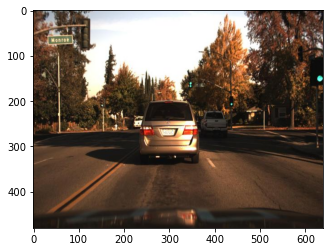

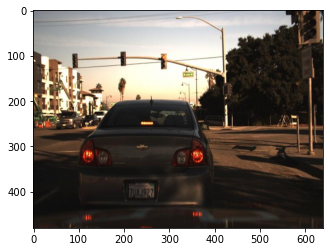

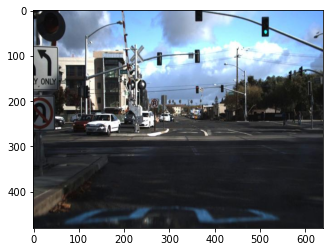

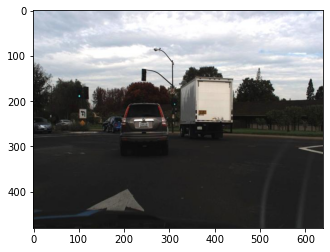

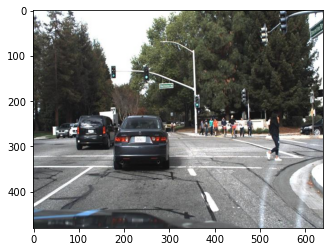

loading annotations into memory...
Done (t=1.41s)
creating index...
index created!
INIT CLASSES:  ['biker']
LENGTH:  2408
number of images in ['biker'] = 2408
filter_pos_pred len dataset:  2408
ground truth # of classes for filtered images: 138, predicted # of classes for filtered images: 90
number of filtered images: 88


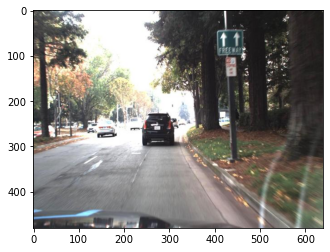

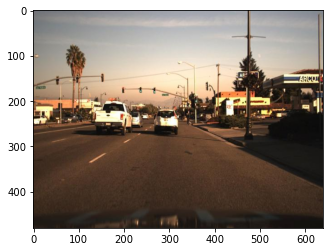

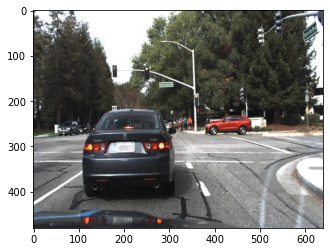

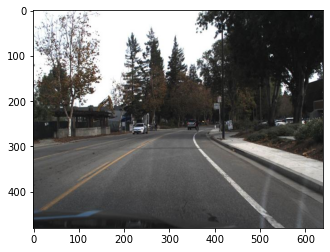

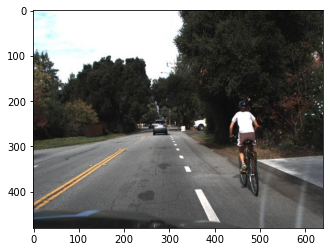

In [ ]:
for cls_str, cls_idx in zip(cls_strs, cls_idxs):

    coco = SubCocoDetection(root=root, annFile=annFile, id_shift=id_shift, img_resize=img_size, classes=cls_str) # Object Instance

    train_data = filter_pos_pred(coco, model, id_shift[cls_idx], cfg, n_imgs) # outputs a bunch of images, based on coco api
    
    for i in [0, 100, 200, 300 , 400]:
      if i < len(coco):
        img, data = coco[i]
        plt.imshow(img)
        plt.show()

        img.save('E:/Summer2021Research/Udacity/sample_images/Udacity_'+cls_str[0]+'_'+str(i)+'.jpg')

**OpenImages (V6?)**

In [ ]:
# # Filtering IDs to download
# import csv

# annRoot = 'E:\\Summer2021Research\\OpenImages\\oidv6-train-annotations-bbox.csv'
# idsRoot = 'E:\\Summer2021Research\\OpenImages\\filtered_ids.txt'
# newCSV = 'E:\\Summer2021Research\\OpenImages\\filtered_bboxs.csv'

# %cd E:\\Summer2021Research\\OpenImages\\
# class_to_ids = {'car':'/m/0k4j', 'person':'/m/01g317', 'truck':'/m/07r04', 'traffic light':'/m/015qff', 'stop sign':'/m/02pv19', 'bicycle':'/m/0199g'}
# class_ids = class_to_ids.values()

# max_class_imgs = 5000

# with open(annRoot) as csv_file, open(idsRoot, 'w') as id_file, open(newCSV, 'w') as new_csv:
#     csv_reader = csv.reader(csv_file, delimiter=',')
#     imgs = line_count = 0
#     curr_imgs = set()
#     class_count = dict()

#     for row in csv_reader:
#       curr_class = row[2]
#       if line_count == 1:
#         print(row)

#       if line_count == 0:
#           print(f'Column names are {", ".join(row)}')
#       # Add File
#       elif curr_class in class_ids:
#         if curr_class not in class_count:
#           class_count[curr_class] = 0
#         # If don't have enough images for category and not already included
#         if class_count[curr_class] < max_class_imgs:
#           new_csv.write(','.join(row) + '\n')
#           if row[0] not in curr_imgs:
#             curr_imgs.add(row[0])
#             id_file.write('train/' + row[0] + '\n')
#             class_count[curr_class] += 1
    
#       line_count += 1
    
#     print('000002b66c9c498e' in curr_imgs)

#     print(f'Filtered {[int(x) for x in class_count.values()]} images.')

[WinError 123] The filename, directory name, or volume label syntax is incorrect: "E:\\\\Summer2021Research\\\\OpenImages\\ class_to_ids = {'car':'/m/0k4j', 'person':'/m/01g317', 'truck':'/m/07r04', 'traffic light':'/m/015qff', 'stop sign':'/m/02pv19', 'bicycle':'/m/0199g'}"
E:\Summer2021Research\OpenImages
Column names are ImageID, Source, LabelName, Confidence, XMin, XMax, YMin, YMax, IsOccluded, IsTruncated, IsGroupOf, IsDepiction, IsInside, XClick1X, XClick2X, XClick3X, XClick4X, XClick1Y, XClick2Y, XClick3Y, XClick4Y
['000002b66c9c498e', 'xclick', '/m/01g317', '1', '0.012500', '0.195312', '0.148438', '0.587500', '0', '1', '0', '0', '0', '0.148438', '0.012500', '0.059375', '0.195312', '0.148438', '0.357812', '0.587500', '0.325000']
True
Filtered [5000, 5000, 5000, 1732, 5000, 372] images.


In [ ]:
import os

class SubOIDetection(torch.utils.data.Dataset):
    """

    Args:
    root (string): Root directory where images are downloaded to.
    classes (string array): Names of categories we want in NuImages format
    img_resize (int 2-tuple): image's current resized size

    transform (callable, optional): A function/transform that  takes in an PIL image and returns a transformed version. E.g, ``transforms.ToTensor``
    target_transform (callable, optional): A function/transform that takes in the target and transforms it.
    transforms (callable, optional): A function/transform that takes input sample and its target as entry and returns a transformed version.
    """

    def __init__(self, root, annRoot, category, model, to_coco, cfg, max_img, img_resize=None, transform=None, target_transform=None, transforms=None):
        self.root = root
        self.transforms = transforms
        self.category = category

        self.img_resize = img_resize
        self.to_coco = to_coco

        anns = dict()

        cat_to_count = dict()

        # Attach array of annotations (arrays) to every image id of the right category
        with open(annRoot, 'r') as ann_file:
          for row in ann_file:
            row = row.split(',')

            cat_to_count[row[2]] = cat_to_count[row[2]] + 1 if row[2] in cat_to_count else 1

            if row[2] == category:
              if row[0] not in anns:
                anns[row[0]] = [row]
              else:
                anns[row[0]].append(row)

        # for k,v in cat_to_count.items():
        #   print(to_coco[k], ' : ', v)
                
        self.dataset = list(anns.keys())
        self.anns = anns

        self.filter_pos(model, to_coco[category], cfg, max_img)

    def __getitem__(self, index):
        """
        Args:
            index (int): index

        Returns:
            img, target (tuple): target is the object returned by ``coco.loadAnns``.
        """

        img_id = self.dataset[index]
        img_str = img_id + '.jpg'
        img = Image.open(os.path.join(self.root, img_str)).convert('RGB') # open the PIL image

        img = img.resize(self.img_resize)

        boxes = []
        labels = []

        anns = self.anns[img_id]
        num_objs = len(anns)
        for ann in anns:

          labels.append(self.to_coco[ann[2]] if ann[2] in self.to_coco else -1)

          bbox = [float(n) for n in ann[4:8]]
          xmin, xmax, ymin, ymax = bbox
          # x_resize = self.img_resize[0] / img_size[0]
          # y_resize = self.img_resize[1] / img_size[1]
          boxes.append([(xmin*img_resize[0]), (ymin*img_resize[1]), (xmax*img_resize[0]), (ymax*img_resize[1])])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["iscrowd"] = iscrowd

        # preprocess image if wanted
        if self.transforms is not None:
            img = self.transforms(img)
            
        return img, target

    def __len__(self):
        return len(self.dataset)

    def filter_pos(self, model, cls, cfg, max_img):
      """ to completely isolate the effect of the perturbation, we have to only use the images that the detector results in correct prediction
      
      returns: 
          - train_data: list[tuple], images that have at least one correct prediction of our target class

      params:
          - dataset: the dataset that we want to filter out
          - model: the object detector we want to test on
          - cls: the target class that we are interested in
          - cfg: config file that contains class category strings for COCO2017 train
          - max_img: max number of images that we want to keep as training data
      """

      # split into train and val data
      train_data = []
      gt_total_count = 0
      pred_total_count = 0
      img_num = 0

      for i in range(len(self.dataset)):
          is_correct, gt_count, pred_count = is_pos_pred(self[i], model, cls, cfg) # dataset[i]=Pil Object
          
          if is_correct is True:
            train_data.append(self.dataset[i])
            img_num += 1
            gt_total_count += gt_count
            pred_total_count += pred_count

            # finish if collected images exceed the desired number of training examples
            if img_num >= max_img:
                break
            
      print('ground truth # of classes for filtered images: {}, predicted # of classes for filtered images: {}'.format(gt_total_count, pred_total_count))
      print('number of filtered images: {}'.format(len(train_data)))
      self.dataset = train_data


In [ ]:
%cd E:\\Summer2021Research\\mask_rcnn\\OpenImages

faster_rcnn = "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"
mask_rcnn =  "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
config_file = mask_rcnn

root = 'E:/Summer2021Research/OpenImages/imgs'
annRoot = 'E:\\Summer2021Research\\OpenImages\\filtered_bboxs.csv'

n_epochs = 250
Xi = 10 # [10, 15, 20]
eps = 20 # [1, 5, 10, 20, 30] 
n_imgs = 500
score_thresh = 0.7
iou_thresh = 0.5

img_resize = (640, 480)
class_to_id = {'car':'/m/0k4j', 'person':'/m/01g317', 'truck':'/m/07r04', 'traffic light':'/m/015qff', 'stop sign':'/m/02pv19', 'bicycle':'/m/0199g'}
model, cfg = get_detector(config_file, score_thresh, data_type='model')

# person=0, bicycle=1, car=2, motorcycle=3, bus=5, truck=7, traffic light=9, stop sign=11
cls_strs = [['pedestrian'], ['car'], ['truck'], ['trafficLight'], ['stop sign'], ['cyclist']]
coco_idxs = [0, 2, 7, 9, 11, 1]
cls_idxs = class_to_id.values()
to_coco = {'/m/0k4j':2, '/m/01g317':0, '/m/07r04':7, '/m/015qff':9, '/m/02pv19':11, '/m/0199g':1}

E:\Summer2021Research\mask_rcnn\OpenImages


The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


In [ ]:
for cls_str, cls_idx in zip(cls_strs[2:], (list)(cls_idxs)[2:]):

    OI = SubOIDetection(root, annRoot, category=cls_idx, model=model, to_coco=to_coco, cfg=cfg, max_img=n_imgs, img_resize=img_resize)
    
    print("class: {}, n_epochs: {}, Xi: {}, epsilon: {}, number of imgs: {}, cls_idx: {}".format(cls_str, n_epochs, Xi, eps, len(OI), cls_idx))

    uap, metric_ls = udos(cfg=cfg, model=model, dataset=OI, n_epochs=n_epochs, Xi=Xi, epsilon=eps, size=img_resize, cls=to_coco[cls_idx])
    metrics = np.array(metric_ls)

    # save list to pickle file
    file_name = 'cls{}_epochs{}_xi{}_eps{}_imgs{}.pkl'.format(cls_str, n_epochs, Xi, eps, len(OI))
    open_file = open(file_name, "wb")
    pickle.dump(metrics, open_file)
    open_file.close()

<ipython-input-5-3d6a597a5ce8>:255: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)


ground truth # of classes for filtered images: 778, predicted # of classes for filtered images: 586
number of filtered images: 500
class: ['truck'], n_epochs: 250, Xi: 10, epsilon: 20, number of imgs: 500, cls_idx: /m/07r04
epoch 1
loss: 1.1408007167577743, perturbation l1-norm: 0.0016756582772359252, instance_level_blind_deg: 1.1397050619125366, img_level_blind_deg: 0.96
epoch 2
loss: 1.1401456999778747, perturbation l1-norm: 0.004969872999936342, instance_level_blind_deg: 1.1366007328033447, img_level_blind_deg: 0.958
epoch 3
loss: 1.134465729355812, perturbation l1-norm: 0.009600167162716389, instance_level_blind_deg: 1.1271926164627075, img_level_blind_deg: 0.956
epoch 4
loss: 1.1324969594478607, perturbation l1-norm: 0.015593567863106728, instance_level_blind_deg: 1.120186448097229, img_level_blind_deg: 0.954
epoch 5
loss: 1.1230061283111572, perturbation l1-norm: 0.022852957248687744, instance_level_blind_deg: 1.1044141054153442, img_level_blind_deg: 0.952
epoch 6
loss: 1.1246609

<ipython-input-3-07b0ff892883>:255: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  outputs.pred_boxes.tensor = torch.tensor(outputs.pred_boxes.tensor, requires_grad=False)


ground truth # of classes for filtered images: 1565, predicted # of classes for filtered images: 1041
number of filtered images: 500


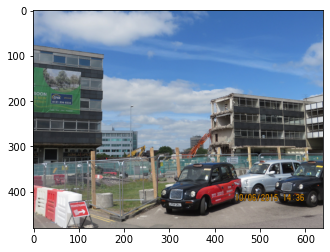

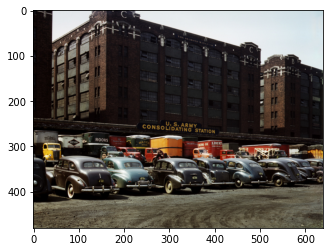

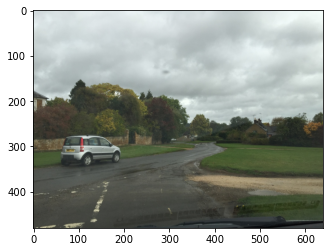

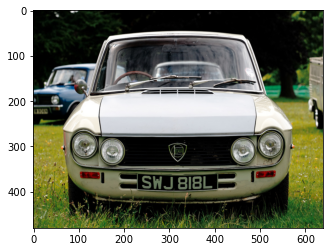

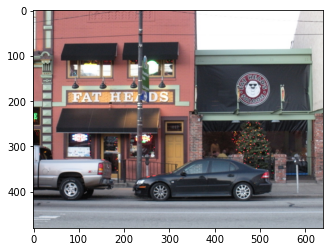

ground truth # of classes for filtered images: 2237, predicted # of classes for filtered images: 1330
number of filtered images: 500


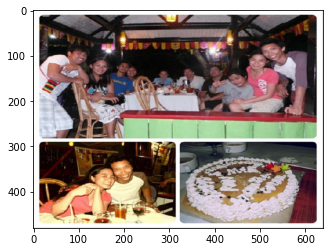

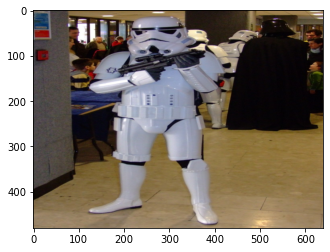

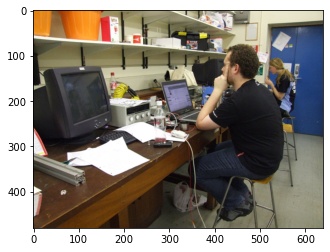

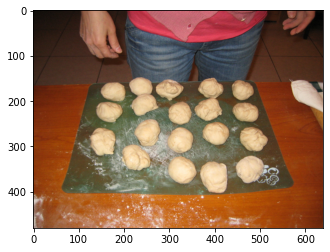

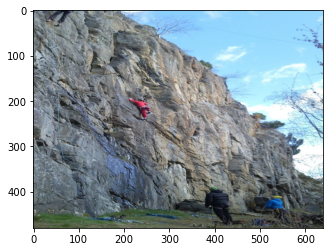

ground truth # of classes for filtered images: 775, predicted # of classes for filtered images: 589
number of filtered images: 500


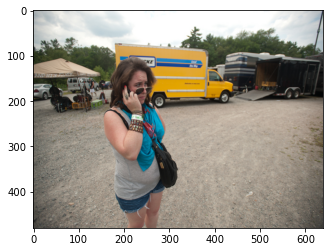

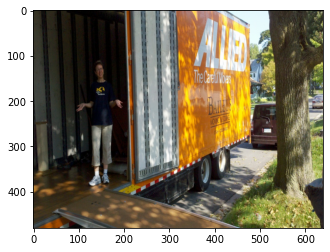

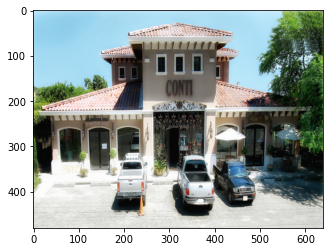

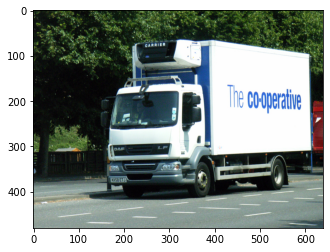

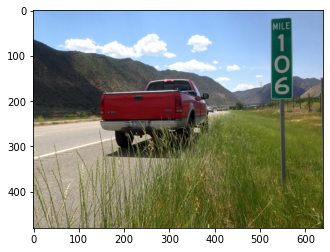

ground truth # of classes for filtered images: 2242, predicted # of classes for filtered images: 1176
number of filtered images: 500


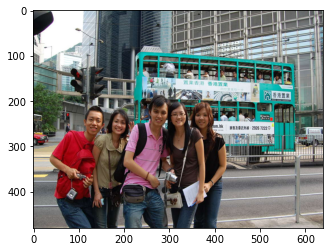

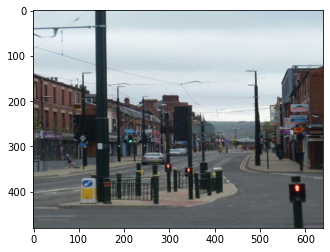

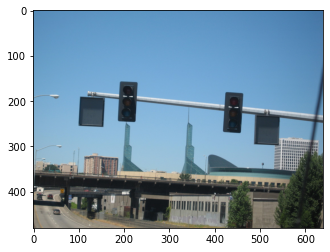

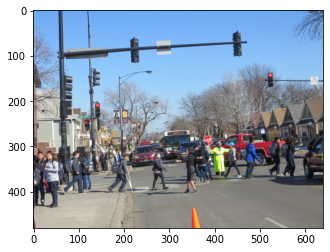

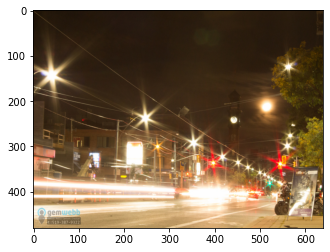

ground truth # of classes for filtered images: 382, predicted # of classes for filtered images: 375
number of filtered images: 363


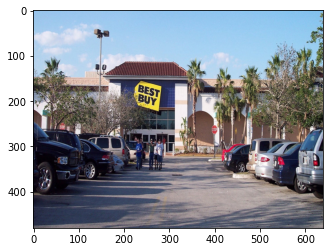

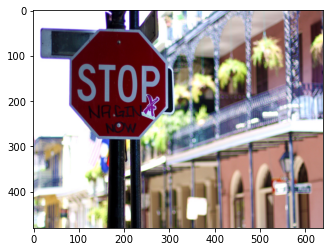

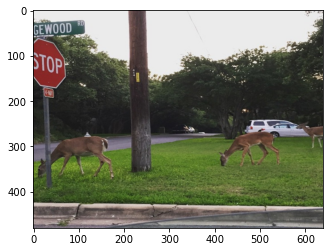

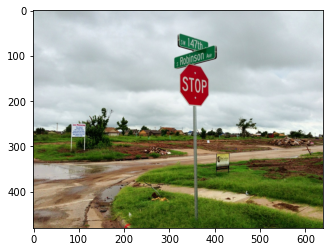

ground truth # of classes for filtered images: 1124, predicted # of classes for filtered images: 731
number of filtered images: 500


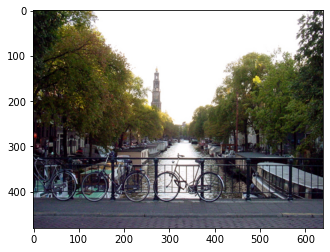

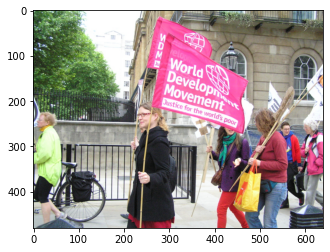

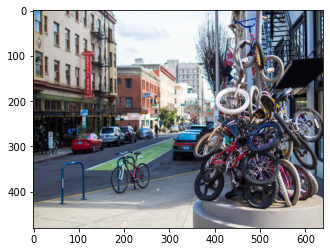

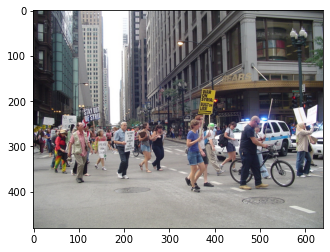

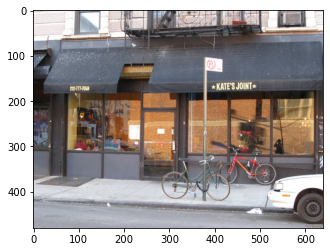

In [ ]:
# Getting sample images
"for cls_str, cls_idx in zip(cls_strs, cls_idxs):

    OI = SubOIDetection(root, annRoot, category=cls_idx, model=model, to_coco=to_coco, cfg=cfg, max_img=n_imgs, img_resize=img_resize)
    
    for i in [0, 100, 200, 300 , 400]:
      if i < len(OI):
        img, data = OI[i]
        plt.imshow(img)
        plt.show()

        img.save('E:/Summer2021Research/OpenImages/sample_images/OpenImages_'+cls_str[0]+'_'+str(i)+'.jpg')

**Waymo**

In [ ]:
import tensorflow as tf

filenames = ['E:\Summer2021Research\waymo-od\data\\validation_segment-10203656353524179475_7625_000_7645_000_with_camera_labels.tfrecord']
raw_dataset = tf.data.TFRecordDataset(filenames)

feature_description = {
    'feature0': tf.io.FixedLenFeature([], tf.int64, default_value=0),
    'feature1': tf.io.FixedLenFeature([], tf.int64, default_value=0),
    'feature2': tf.io.FixedLenFeature([], tf.string, default_value=''),
    'feature3': tf.io.FixedLenFeature([], tf.float32, default_value=0.0),
}

def _parse_function(example_proto):
  # Parse the input `tf.train.Example` proto using the dictionary above.
  return tf.io.parse_single_example(example_proto, feature_description)

In [ ]:
for raw_record in raw_dataset.take(1):
  print(repr(raw_record)[0:200])

parsed_dataset = raw_dataset.map(_parse_function)

for parsed_record in parsed_dataset.take(1):
  print(repr(parsed_record))

<tf.Tensor: shape=(), dtype=string, numpy=b'\n\xa3\x15\n&10203656353524179475_7625_000_7645_000\x12\xee\x01\x08\x01\x11N\xaa@#\x18\x16\xa0@\x11N\xaa@#\x18\x16\xa0@\x11\xfeYo\x9b\xff8\x8d@\x11`@\xc8wk\


UnicodeDecodeError: ignored

**Darknet/Yolo V4**

In [3]:
import darknet



FileNotFoundError: ignored